<span style="font-size:20px;">1 Data</span><br>
<span style="font-size:18px;">1.1 Python Environment Configuration</span>

In [7]:
!apt update
!apt install python3.10 -y

Hit:1 https://developer.download.nvidia.cn/compute/cuda/repos/ubuntu2204/x86_64  InRelease
Hit:2 http://archive.ubuntu.com/ubuntu jammy InRelease                         
Hit:3 http://security.ubuntu.com/ubuntu jammy-security InRelease
Hit:4 http://archive.ubuntu.com/ubuntu jammy-updates InRelease
Hit:5 http://archive.ubuntu.com/ubuntu jammy-backports InRelease
Reading package lists... Done
Building dependency tree... Done
Reading state information... Done
77 packages can be upgraded. Run 'apt list --upgradable' to see them.
Reading package lists... Done
Building dependency tree... Done
Reading state information... Done
The following additional packages will be installed:
  libexpat1 libmpdec3 libpython3.10-minimal libpython3.10-stdlib media-types
  python3.10-minimal
Suggested packages:
  python3.10-venv python3.10-doc binfmt-support
The following NEW packages will be installed:
  libexpat1 libmpdec3 libpython3.10-minimal libpython3.10-stdlib media-types
  python3.10 python3.10-minima

In [8]:
!update-alternatives --install /usr/bin/python3 python3 /usr/bin/python3.10 100

update-alternatives: using /usr/bin/python3.10 to provide /usr/bin/python3 (python3) in auto mode


In [9]:
!python3 --version

Python 3.10.12


In [4]:
!apt-get install --reinstall python3-pip -y

Reading package lists... Done
Building dependency tree... Done
Reading state information... Done
0 upgraded, 0 newly installed, 1 reinstalled, 0 to remove and 77 not upgraded.
Need to get 1306 kB of archives.
After this operation, 0 B of additional disk space will be used.
Get:1 http://archive.ubuntu.com/ubuntu jammy-updates/universe amd64 python3-pip all 22.0.2+dfsg-1ubuntu0.6 [1306 kB]
Fetched 1306 kB in 2s (658 kB/s)       
debconf: delaying package configuration, since apt-utils is not installed
(Reading database ... 18463 files and directories currently installed.)
Preparing to unpack .../python3-pip_22.0.2+dfsg-1ubuntu0.6_all.deb ...
Unpacking python3-pip (22.0.2+dfsg-1ubuntu0.6) over (22.0.2+dfsg-1ubuntu0.6) ...
Setting up python3-pip (22.0.2+dfsg-1ubuntu0.6) ...


In [5]:
!pwd

/inspire/hdd/project/urbanlowaltitude/fengkairui-25026/yinminghao/corrdiff_solar_gcl/pipeline


In [6]:
!mkdir input_data

mkdir: cannot create directory ‘input_data’: File exists


<span style="font-size:18px;">1.2 Data Download</span>

In [7]:
!pip install gsutil

In [8]:
# Define the year, month, and date
year = '2020'
month = '07'
date = '21'

# Define the variables for pressure-level data
pressure_variables = [
    "geopotential",
    "specific_humidity",
    "temperature",
    "u_component_of_wind",
    "v_component_of_wind"
]

# Define the variables for single-level surface data
surface_variables = [
    "mean_sea_level_pressure",
    "10m_u_component_of_wind",
    "10m_v_component_of_wind",
    "2m_temperature",
    "100m_u_component_of_wind",
    "100m_v_component_of_wind",
    "surface_pressure",
    "total_column_water_vapour"
]

# Initialize empty list to hold gsutil commands
commands = []

# Construct gsutil commands for pressure-level variables
for variable in pressure_variables:
    commands.append(
        f"gs://gcp-public-data-arco-era5/raw/date-variable-pressure_level/{year}/{month}/{date}/{variable}"
    )

# Construct gsutil commands for single-level surface variables
for variable in surface_variables:
    commands.append(
        f"gs://gcp-public-data-arco-era5/raw/date-variable-single_level/{year}/{month}/{date}/{variable}"
    )

# Combine all commands into a single gsutil -m cp command
full_command = f"gsutil -m cp -r {' '.join(commands)} ./inputs"

# Run the command
!{full_command}

Copying gs://gcp-public-data-arco-era5/raw/date-variable-pressure_level/2020/07/21/geopotential/1.nc...
Copying gs://gcp-public-data-arco-era5/raw/date-variable-pressure_level/2020/07/21/geopotential/10.nc...
Copying gs://gcp-public-data-arco-era5/raw/date-variable-pressure_level/2020/07/21/geopotential/100.nc...
Copying gs://gcp-public-data-arco-era5/raw/date-variable-pressure_level/2020/07/21/geopotential/1000.nc...
Copying gs://gcp-public-data-arco-era5/raw/date-variable-pressure_level/2020/07/21/geopotential/125.nc...
Copying gs://gcp-public-data-arco-era5/raw/date-variable-pressure_level/2020/07/21/geopotential/150.nc...
Copying gs://gcp-public-data-arco-era5/raw/date-variable-pressure_level/2020/07/21/geopotential/175.nc...
Copying gs://gcp-public-data-arco-era5/raw/date-variable-pressure_level/2020/07/21/geopotential/2.nc...
Copying gs://gcp-public-data-arco-era5/raw/date-variable-pressure_level/2020/07/21/geopotential/20.nc...
Copying gs://gcp-public-data-arco-era5/raw/date-var

<span style="font-size:20px;">2 Dependencies and Installation</span>

In [9]:
!pip3 install torch torchvision -i http://nexus.sii.shaipower.online/repository/pypi/simple --trusted-host nexus.sii.shaipower.online

Looking in indexes: http://nexus.sii.shaipower.online/repository/pypi/simple


In [10]:
!pip install nvidia-modulus[all] -i http://nexus.sii.shaipower.online/repository/pypi/simple --trusted-host nexus.sii.shaipower.online

Looking in indexes: http://nexus.sii.shaipower.online/repository/pypi/simple
  Using cached http://nexus.sii.shaipower.online/repository/pypi/packages/torch-harmonics/0.6.5/torch_harmonics-0.6.5-py3-none-any.whl (63 kB)
  Attempting uninstall: torch-harmonics
    Found existing installation: torch_harmonics 0.8.0
    Uninstalling torch_harmonics-0.8.0:
      Successfully uninstalled torch_harmonics-0.8.0
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
makani 0.2.0 requires torch-harmonics>=0.8.0, but you have torch-harmonics 0.6.5 which is incompatible.


In [11]:
!pip install earth2studio -i http://nexus.sii.shaipower.online/repository/pypi/simple --trusted-host nexus.sii.shaipower.online

Looking in indexes: http://nexus.sii.shaipower.online/repository/pypi/simple


In [12]:
!pip install earth2studio[data]

In [13]:
!pip install "makani @ git+https://github.com/NVIDIA/modulus-makani.git@49280812513d8f1daf872a2e9343855a6adb3acf"

  Using cached makani-0.2.0-py3-none-any.whl
  Using cached torch_harmonics-0.8.0-py3-none-any.whl
  Attempting uninstall: torch-harmonics
    Found existing installation: torch-harmonics 0.6.5
    Uninstalling torch-harmonics-0.6.5:
      Successfully uninstalled torch-harmonics-0.6.5


<span style="font-size:20px;">3 Inference</span><br>
<span style="font-size:18px;">3.1 Inference Using ERA5 Data</span>

In [2]:
import xarray as xr
import os
import numpy as np
from datetime import datetime
from earth2studio.utils.type import TimeArray, VariableArray

class DataLocal:
    """
    A class for loading weather data at a specific timestamp.
    
    """
    # --- Define all configuration as class attributes ---
    # Fixed set of all variables
    VARIABLES = [
        "u10m", "v10m", "u100m", "v100m", "t2m", "sp", "msl", "tcwv",
        "u50", "u100", "u150", "u200", "u250", "u300", "u400", "u500", "u600", "u700", "u850", "u925", "u1000",
        "v50", "v100", "v150", "v200", "v250", "v300", "v400", "v500", "v600", "v700", "v850", "v925", "v1000",
        "z50", "z100", "z150", "z200", "z250", "z300", "z400", "z500", "z600", "z700", "z850", "z925", "z1000",
        "t50", "t100", "t150", "t200", "t250", "t300", "t400", "t500", "t600", "t700", "t850", "t925", "t1000",
        "q50", "q100", "q150", "q200", "q250", "q300", "q400", "q500", "q600", "q700", "q850", "q925", "q1000",
    ]
    # Timestamp to load
    SPECIFIC_TIME = "2020-07-21T18:00:00"
    SURFACE_VARIABLES_MAPPING = {
        "u10m": "10m_u_component_of_wind", "v10m": "10m_v_component_of_wind", "u100m": "100m_u_component_of_wind",
        "v100m": "100m_v_component_of_wind", "t2m": "2m_temperature", "sp": "surface_pressure",
        "msl": "mean_sea_level_pressure", "tcwv": "total_column_water_vapour",
    }
    UPPER_VARIABLES_MAPPING = {
        "u": "u_component_of_wind", "v": "v_component_of_wind", "z": "geopotential",
        "t": "temperature", "q": "specific_humidity",
    }
    PRESSURE_LEVELS = ["50", "100", "150", "200", "250", "300", "400", "500", "600", "700", "850", "925", "1000"]
    
    def __init__(self, base_path: str):
        """
        Initialize the data loader.
        Args:
            base_path (str): Root directory for the nc files.
        """
        self.base_path = base_path
    
    def _read_and_slice(self, file_path: str, specific_time: str) -> np.ndarray | None:
        """
        Read a single file and return the slice at the specific timestamp as a numpy array.
        """
        if not os.path.exists(file_path):
            print(f"Warning: File not found: {file_path}")
            return None
        with xr.open_dataset(file_path) as ds:
            for var_name, da in ds.data_vars.items():
                if len(da.shape) == 3 and "time" in da.dims:
                    specific_time_np64 = np.datetime64(specific_time)
                    if specific_time_np64 in da.time.values:
                        return da.sel(time=specific_time_np64).values
                    else:
                        print(f"Warning: Time '{specific_time}' not found in {file_path}. Skipping.")
                        return None
        print(f"Warning: No valid variables found in file {file_path}.")
        return None
    
    def __call__(
        self,
        _time: datetime | list[datetime] | TimeArray,
        _variable: str | list[str] | VariableArray,
    ) -> xr.DataArray:
        """
        Load and assemble data for the predefined timestamp and variable set.
        
        """
        all_data = []
        lat, lon = None, None
        for var in self.VARIABLES:
            data = None
            file_path = ""
            if var in self.SURFACE_VARIABLES_MAPPING:
                variable_name = self.SURFACE_VARIABLES_MAPPING[var]
                file_path = os.path.join(self.base_path, variable_name, "surface.nc")
                data = self._read_and_slice(file_path, self.SPECIFIC_TIME)
            else:
                for upper_var, upper_file_name in self.UPPER_VARIABLES_MAPPING.items():
                    if var.startswith(upper_var):
                        pressure_level = var[len(upper_var):]
                        if pressure_level in self.PRESSURE_LEVELS:
                            file_path = os.path.join(self.base_path, upper_file_name, f"{pressure_level}.nc")
                            data = self._read_and_slice(file_path, self.SPECIFIC_TIME)
                            break
            
            if data is not None:
                all_data.append(data)
                if lat is None or lon is None and os.path.exists(file_path):
                     with xr.open_dataset(file_path) as ds:
                        lat = ds["latitude"].values
                        lon = ds["longitude"].values
        
        if not all_data:
            raise ValueError(f"No data successfully loaded for timestamp {self.SPECIFIC_TIME}.")
        data_array = np.stack(all_data, axis=0)
        data_array = np.expand_dims(data_array, axis=0)
        final_data = xr.DataArray(
            data_array,
            dims=["time", "variable", "lat", "lon"],
            coords={
                "time": [np.datetime64(self.SPECIFIC_TIME)],
                "variable": self.VARIABLES,
                "lat": lat,
                "lon": lon,
            },
        )
        return final_data

In [3]:
# SPDX-FileCopyrightText: Copyright (c) 2024 NVIDIA CORPORATION & AFFILIATES.
# SPDX-FileCopyrightText: All rights reserved.
# SPDX-License-Identifier: Apache-2.0
#
# Licensed under the Apache License, Version 2.0 (the "License");
# you may not use this file except in compliance with the License.
# You may obtain a copy of the License at
#
# http://www.apache.org/licenses/LICENSE-2.0
#
# Unless required by applicable law or agreed to in writing, software
# distributed under the License is distributed on an "AS IS" BASIS,
# WITHOUT WARRANTIES OR CONDITIONS OF ANY KIND, either express or implied.
# See the License for the specific language governing permissions and
# limitations under the License.

import os
#os.environ["CUDA_VISIBLE_DEVICES"] = "1"
os.environ["EARTH2STUDIO_PACKAGE_TIMEOUT"] = "10000"
import subprocess as sp

os.makedirs("outputs", exist_ok=True)
output_file="./outputs/solar.nc"
from earth2studio.data import GFS, CDS, IFS
from earth2studio.io.netcdf4 import NetCDF4Backend
from earth2studio.models.auto import Package
from earth2studio.models.px import SFNO
from earth2studio.run import deterministic, diagnostic

from fcinterp.interp import ForecastInterpolation
from diagnostic.solarradiation_1h_afno import SolarRadiationAFNO
from collections import OrderedDict
from datetime import datetime
from math import ceil

import numpy as np
import torch
from tqdm import tqdm

from earth2studio.data import DataSource, fetch_data
from earth2studio.io import IOBackend
from earth2studio.models.dx import DiagnosticModel
from earth2studio.models.px import PrognosticModel
from earth2studio.perturbation import Perturbation
from earth2studio.utils.coords import CoordSystem, map_coords
from earth2studio.utils.time import to_time_array
from solarcorrdiff import scall_in_VARIABLES, SolarCorrdiffAll, scall_out_VARIABLES
import matplotlib.pyplot as plt
import copy
# Load the default model package which downloads the check point from NGC
forecast_package = SFNO.load_default_package()
forecast_model = SFNO.load_model(forecast_package)

# Load the interpolation model
interp_package_path = "./fcinterp"
prognostic_model = ForecastInterpolation.load_model(
        Package(interp_package_path, cache=False),
        fc_model=forecast_model,
)

# Load the diagnostic model for ssrd
diagnostic_package_path = "./diagnostic" 
diagnostic_model = SolarRadiationAFNO.load_model(
        Package(diagnostic_package_path, cache=False),
)


# Load the downscaling model for ssrd
solarcorrdiff_package_path = "./solarcorrdiff" 
solarcorrdiff_model = SolarCorrdiffAll.load_model(
        Package(solarcorrdiff_package_path, cache=False),
)

# Create the data source
# data = GFS()
data = DataLocal('./inputs')

# Create the IO handler, store in memory
io = NetCDF4Backend(output_file)

timesteps = 24 * 7  # 10 mins per step
time= ["2020-07-21T18:00:00"]  # start time

def diagnostic_sr(
    time: list[str] | list[datetime] | list[np.datetime64],
    nsteps: int,
    prognostic: PrognosticModel,
    diagnostic: DiagnosticModel,
    solarcorrdiffic: SolarCorrdiffAll,
    data: DataSource,
    io: IOBackend,
    output_coords: CoordSystem = OrderedDict({}),
    device: torch.device | None = None,
) -> IOBackend:
    """Built in diagnostic workflow.
    This workflow creates a determinstic inference pipeline that couples a prognostic
    model with a diagnostic model.

    Parameters
    ----------
    time : list[str] | list[datetime] | list[np.datetime64]
        List of string, datetimes or np.datetime64
    nsteps : int
        Number of forecast steps
    prognostic : PrognosticModel
        Prognostic model
    diagnostic: DiagnosticModel
        Diagnostic model, must be on same coordinate axis as prognostic
    data : DataSource
        Data source
    io : IOBackend
        IO object
    output_coords: CoordSystem, optional
        IO output coordinate system override, by default OrderedDict({})
    device : torch.device, optional
        Device to run inference on, by default None

    Returns
    -------
    IOBackend
        Output IO object
    """
    # sphinx - diagnostic end
    print("Running diagnostic workflow!")
    # Load model onto the device
    device = (
        device
        if device is not None
        else torch.device("cuda" if torch.cuda.is_available() else "cpu")
    )
    print(f"Inference device: {device}")
    prognostic = prognostic.to(device)
    diagnostic = diagnostic.to(device)
    solarcorrdiffic = solarcorrdiffic.to(device)
    # Fetch data from data source and load onto device
    prognositc_ic = prognostic.input_coords()
    diagnostic_ic = diagnostic.input_coords()
    time = to_time_array(time)

    x, coords = fetch_data(
        source=data,
        time=time,
        variable=prognositc_ic["variable"],
        lead_time=prognositc_ic["lead_time"],
        device=device,
    )
    
    print(f"Fetched data from {data.__class__.__name__}")

    if output_coords:
        total_coords = output_coords
    else:
        total_coords = solarcorrdiffic.get_total_coord(time, nsteps)

    io.add_array(total_coords, "ssrd")

    # Map lat and lon if needed
    x, coords = map_coords(x, coords, prognositc_ic)
    
    # Create prognostic iterator
    model = prognostic.create_iterator(x, coords)

    print("Inference starting!")
    with tqdm(total=nsteps + 1, desc="Running inference") as pbar:
        for step, (x, coords) in enumerate(model):
            print("intime", time)
            print("protime", coords["time"])
            
            pro_out, pro_out_coord = copy.deepcopy(x), copy.deepcopy(coords) # record the output of pro model
            
            x, coords = map_coords(x, coords, diagnostic_ic)
            x, coords = diagnostic(x, coords)

            print("diatime", coords["time"])

            dia_out, dia_out_coord = copy.deepcopy(x), copy.deepcopy(coords)

            x, coords = solarcorrdiffic(pro_out, pro_out_coord, dia_out, dia_out_coord, True, step)
            
            if x is not None:
                x, coords = map_coords(x, coords, output_coords)
                coords.pop("variable")
                io.write(x, coords, "ssrd")

            pbar.update(1)
            if step == nsteps:
                break

    print("Inference complete")
    return io

def get_gpu_memory():
    command = "nvidia-smi --query-gpu=memory.free --format=csv"
    memory_free_info = sp.check_output(command.split()).decode('ascii').split('\n')[:-1][1:]
    memory_free_values = [int(x.split()[0]) for i, x in enumerate(memory_free_info)]
    return memory_free_values

# run inference
with torch.no_grad():
    diagnostic_sr(time, timesteps, prognostic_model, diagnostic_model, solarcorrdiff_model, data, io)

Running diagnostic workflow!
Inference device: cuda
Fetched data from DataLocal
Inference starting!


Running inference:   0%|          | 0/169 [00:00<?, ?it/s]

intime ['2020-07-21T18:00:00.000000000']
protime ['2020-07-21T18:00:00.000000000']
2020-07-21 18:00:00


Running inference:   1%|          | 1/169 [00:00<01:43,  1.63it/s]

diatime ['2020-07-21T18:00:00.000000000']
intime ['2020-07-21T18:00:00.000000000']
protime ['2020-07-21T18:00:00.000000000']
2020-07-21 19:00:00
diatime ['2020-07-21T18:00:00.000000000']



Running inference:   1%|          | 2/169 [00:17<28:04, 10.08s/it]

intime ['2020-07-21T18:00:00.000000000']
protime ['2020-07-21T18:00:00.000000000']
2020-07-21 20:00:00
diatime ['2020-07-21T18:00:00.000000000']



Running inference:   2%|▏         | 3/169 [00:31<33:12, 12.01s/it]

intime ['2020-07-21T18:00:00.000000000']
protime ['2020-07-21T18:00:00.000000000']
2020-07-21 21:00:00
diatime ['2020-07-21T18:00:00.000000000']



Running inference:   2%|▏         | 4/169 [00:45<35:11, 12.80s/it]

intime ['2020-07-21T18:00:00.000000000']
protime ['2020-07-21T18:00:00.000000000']
2020-07-21 22:00:00
diatime ['2020-07-21T18:00:00.000000000']



Running inference:   3%|▎         | 5/169 [00:59<36:14, 13.26s/it]

intime ['2020-07-21T18:00:00.000000000']
protime ['2020-07-21T18:00:00.000000000']
2020-07-21 23:00:00
diatime ['2020-07-21T18:00:00.000000000']



Running inference:   4%|▎         | 6/169 [01:13<36:52, 13.57s/it]

intime ['2020-07-21T18:00:00.000000000']
protime ['2020-07-21T18:00:00.000000000']
2020-07-22 00:00:00
diatime ['2020-07-21T18:00:00.000000000']



Running inference:   4%|▍         | 7/169 [01:27<36:22, 13.47s/it]

intime ['2020-07-21T18:00:00.000000000']
protime ['2020-07-21T18:00:00.000000000']
2020-07-22 01:00:00
diatime ['2020-07-21T18:00:00.000000000']



Running inference:   5%|▍         | 8/169 [01:41<37:10, 13.86s/it]

intime ['2020-07-21T18:00:00.000000000']
protime ['2020-07-21T18:00:00.000000000']
2020-07-22 02:00:00
diatime ['2020-07-21T18:00:00.000000000']



Running inference:   5%|▌         | 9/169 [01:56<37:17, 13.98s/it]

intime ['2020-07-21T18:00:00.000000000']
protime ['2020-07-21T18:00:00.000000000']
2020-07-22 03:00:00
diatime ['2020-07-21T18:00:00.000000000']



Running inference:   6%|▌         | 10/169 [02:10<37:17, 14.07s/it]

intime ['2020-07-21T18:00:00.000000000']
protime ['2020-07-21T18:00:00.000000000']
2020-07-22 04:00:00
diatime ['2020-07-21T18:00:00.000000000']



Running inference:   7%|▋         | 11/169 [02:24<37:14, 14.14s/it]

intime ['2020-07-21T18:00:00.000000000']
protime ['2020-07-21T18:00:00.000000000']
2020-07-22 05:00:00
diatime ['2020-07-21T18:00:00.000000000']



Running inference:   7%|▋         | 12/169 [02:39<37:31, 14.34s/it]

intime ['2020-07-21T18:00:00.000000000']
protime ['2020-07-21T18:00:00.000000000']
2020-07-22 06:00:00
diatime ['2020-07-21T18:00:00.000000000']



Running inference:   8%|▊         | 13/169 [02:52<36:32, 14.05s/it]

intime ['2020-07-21T18:00:00.000000000']
protime ['2020-07-21T18:00:00.000000000']
2020-07-22 07:00:00
diatime ['2020-07-21T18:00:00.000000000']



Running inference:   8%|▊         | 14/169 [03:07<36:47, 14.24s/it]

intime ['2020-07-21T18:00:00.000000000']
protime ['2020-07-21T18:00:00.000000000']
2020-07-22 08:00:00
diatime ['2020-07-21T18:00:00.000000000']



Running inference:   9%|▉         | 15/169 [03:21<36:39, 14.28s/it]

intime ['2020-07-21T18:00:00.000000000']
protime ['2020-07-21T18:00:00.000000000']
2020-07-22 09:00:00
diatime ['2020-07-21T18:00:00.000000000']



Running inference:   9%|▉         | 16/169 [03:36<36:24, 14.28s/it]

intime ['2020-07-21T18:00:00.000000000']
protime ['2020-07-21T18:00:00.000000000']
2020-07-22 10:00:00
diatime ['2020-07-21T18:00:00.000000000']



Running inference:  10%|█         | 17/169 [03:50<36:09, 14.27s/it]

intime ['2020-07-21T18:00:00.000000000']
protime ['2020-07-21T18:00:00.000000000']
2020-07-22 11:00:00
diatime ['2020-07-21T18:00:00.000000000']



Running inference:  11%|█         | 18/169 [04:04<35:52, 14.25s/it]

intime ['2020-07-21T18:00:00.000000000']
protime ['2020-07-21T18:00:00.000000000']
2020-07-22 12:00:00
diatime ['2020-07-21T18:00:00.000000000']



Running inference:  11%|█         | 19/169 [04:17<34:51, 13.94s/it]

intime ['2020-07-21T18:00:00.000000000']
protime ['2020-07-21T18:00:00.000000000']
2020-07-22 13:00:00
diatime ['2020-07-21T18:00:00.000000000']



Running inference:  12%|█▏        | 20/169 [04:32<35:01, 14.11s/it]

intime ['2020-07-21T18:00:00.000000000']
protime ['2020-07-21T18:00:00.000000000']
2020-07-22 14:00:00
diatime ['2020-07-21T18:00:00.000000000']



Running inference:  12%|█▏        | 21/169 [04:46<34:45, 14.09s/it]

intime ['2020-07-21T18:00:00.000000000']
protime ['2020-07-21T18:00:00.000000000']
2020-07-22 15:00:00
diatime ['2020-07-21T18:00:00.000000000']



Running inference:  13%|█▎        | 22/169 [05:00<34:28, 14.07s/it]

intime ['2020-07-21T18:00:00.000000000']
protime ['2020-07-21T18:00:00.000000000']
2020-07-22 16:00:00
diatime ['2020-07-21T18:00:00.000000000']



Running inference:  14%|█▎        | 23/169 [05:14<34:13, 14.07s/it]

intime ['2020-07-21T18:00:00.000000000']
protime ['2020-07-21T18:00:00.000000000']
2020-07-22 17:00:00
diatime ['2020-07-21T18:00:00.000000000']



Running inference:  14%|█▍        | 24/169 [05:29<34:27, 14.26s/it]

intime ['2020-07-21T18:00:00.000000000']
protime ['2020-07-21T18:00:00.000000000']
2020-07-22 18:00:00
diatime ['2020-07-21T18:00:00.000000000']



Running inference:  15%|█▍        | 25/169 [05:42<33:26, 13.94s/it]

intime ['2020-07-21T18:00:00.000000000']
protime ['2020-07-21T18:00:00.000000000']
2020-07-22 19:00:00
diatime ['2020-07-21T18:00:00.000000000']



Running inference:  15%|█▌        | 26/169 [05:56<33:38, 14.12s/it]

intime ['2020-07-21T18:00:00.000000000']
protime ['2020-07-21T18:00:00.000000000']
2020-07-22 20:00:00
diatime ['2020-07-21T18:00:00.000000000']



Running inference:  16%|█▌        | 27/169 [06:10<33:21, 14.09s/it]

intime ['2020-07-21T18:00:00.000000000']
protime ['2020-07-21T18:00:00.000000000']
2020-07-22 21:00:00
diatime ['2020-07-21T18:00:00.000000000']



Running inference:  17%|█▋        | 28/169 [06:25<33:07, 14.10s/it]

intime ['2020-07-21T18:00:00.000000000']
protime ['2020-07-21T18:00:00.000000000']
2020-07-22 22:00:00
diatime ['2020-07-21T18:00:00.000000000']



Running inference:  17%|█▋        | 29/169 [06:39<32:52, 14.09s/it]

intime ['2020-07-21T18:00:00.000000000']
protime ['2020-07-21T18:00:00.000000000']
2020-07-22 23:00:00
diatime ['2020-07-21T18:00:00.000000000']



Running inference:  18%|█▊        | 30/169 [06:53<32:44, 14.13s/it]

intime ['2020-07-21T18:00:00.000000000']
protime ['2020-07-21T18:00:00.000000000']
2020-07-23 00:00:00
diatime ['2020-07-21T18:00:00.000000000']



Running inference:  18%|█▊        | 31/169 [07:06<31:56, 13.88s/it]

intime ['2020-07-21T18:00:00.000000000']
protime ['2020-07-21T18:00:00.000000000']
2020-07-23 01:00:00
diatime ['2020-07-21T18:00:00.000000000']



Running inference:  19%|█▉        | 32/169 [07:21<32:14, 14.12s/it]

intime ['2020-07-21T18:00:00.000000000']
protime ['2020-07-21T18:00:00.000000000']
2020-07-23 02:00:00
diatime ['2020-07-21T18:00:00.000000000']



Running inference:  20%|█▉        | 33/169 [07:35<32:05, 14.16s/it]

intime ['2020-07-21T18:00:00.000000000']
protime ['2020-07-21T18:00:00.000000000']
2020-07-23 03:00:00
diatime ['2020-07-21T18:00:00.000000000']



Running inference:  20%|██        | 34/169 [07:49<31:56, 14.20s/it]

intime ['2020-07-21T18:00:00.000000000']
protime ['2020-07-21T18:00:00.000000000']
2020-07-23 04:00:00
diatime ['2020-07-21T18:00:00.000000000']



Running inference:  21%|██        | 35/169 [08:04<31:45, 14.22s/it]

intime ['2020-07-21T18:00:00.000000000']
protime ['2020-07-21T18:00:00.000000000']
2020-07-23 05:00:00
diatime ['2020-07-21T18:00:00.000000000']



Running inference:  21%|██▏       | 36/169 [08:18<31:33, 14.24s/it]

intime ['2020-07-21T18:00:00.000000000']
protime ['2020-07-21T18:00:00.000000000']
2020-07-23 06:00:00
diatime ['2020-07-21T18:00:00.000000000']



Running inference:  22%|██▏       | 37/169 [08:31<30:44, 13.97s/it]

intime ['2020-07-21T18:00:00.000000000']
protime ['2020-07-21T18:00:00.000000000']
2020-07-23 07:00:00
diatime ['2020-07-21T18:00:00.000000000']



Running inference:  22%|██▏       | 38/169 [08:46<30:59, 14.19s/it]

intime ['2020-07-21T18:00:00.000000000']
protime ['2020-07-21T18:00:00.000000000']
2020-07-23 08:00:00
diatime ['2020-07-21T18:00:00.000000000']



Running inference:  23%|██▎       | 39/169 [09:01<31:12, 14.41s/it]

intime ['2020-07-21T18:00:00.000000000']
protime ['2020-07-21T18:00:00.000000000']
2020-07-23 09:00:00
diatime ['2020-07-21T18:00:00.000000000']



Running inference:  24%|██▎       | 40/169 [09:15<30:53, 14.37s/it]

intime ['2020-07-21T18:00:00.000000000']
protime ['2020-07-21T18:00:00.000000000']
2020-07-23 10:00:00
diatime ['2020-07-21T18:00:00.000000000']



Running inference:  24%|██▍       | 41/169 [09:29<30:34, 14.33s/it]

intime ['2020-07-21T18:00:00.000000000']
protime ['2020-07-21T18:00:00.000000000']
2020-07-23 11:00:00
diatime ['2020-07-21T18:00:00.000000000']



Running inference:  25%|██▍       | 42/169 [09:44<30:15, 14.30s/it]

intime ['2020-07-21T18:00:00.000000000']
protime ['2020-07-21T18:00:00.000000000']
2020-07-23 12:00:00
diatime ['2020-07-21T18:00:00.000000000']



Running inference:  25%|██▌       | 43/169 [09:57<29:20, 13.97s/it]

intime ['2020-07-21T18:00:00.000000000']
protime ['2020-07-21T18:00:00.000000000']
2020-07-23 13:00:00
diatime ['2020-07-21T18:00:00.000000000']



Running inference:  26%|██▌       | 44/169 [10:11<29:28, 14.15s/it]

intime ['2020-07-21T18:00:00.000000000']
protime ['2020-07-21T18:00:00.000000000']
2020-07-23 14:00:00
diatime ['2020-07-21T18:00:00.000000000']



Running inference:  27%|██▋       | 45/169 [10:25<29:11, 14.12s/it]

intime ['2020-07-21T18:00:00.000000000']
protime ['2020-07-21T18:00:00.000000000']
2020-07-23 15:00:00
diatime ['2020-07-21T18:00:00.000000000']



Running inference:  27%|██▋       | 46/169 [10:40<28:56, 14.12s/it]

intime ['2020-07-21T18:00:00.000000000']
protime ['2020-07-21T18:00:00.000000000']
2020-07-23 16:00:00
diatime ['2020-07-21T18:00:00.000000000']



Running inference:  28%|██▊       | 47/169 [10:54<28:45, 14.14s/it]

intime ['2020-07-21T18:00:00.000000000']
protime ['2020-07-21T18:00:00.000000000']
2020-07-23 17:00:00
diatime ['2020-07-21T18:00:00.000000000']



Running inference:  28%|██▊       | 48/169 [11:08<28:31, 14.14s/it]

intime ['2020-07-21T18:00:00.000000000']
protime ['2020-07-21T18:00:00.000000000']
2020-07-23 18:00:00
diatime ['2020-07-21T18:00:00.000000000']



Running inference:  29%|██▉       | 49/169 [11:21<27:40, 13.84s/it]

intime ['2020-07-21T18:00:00.000000000']
protime ['2020-07-21T18:00:00.000000000']
2020-07-23 19:00:00
diatime ['2020-07-21T18:00:00.000000000']



Running inference:  30%|██▉       | 50/169 [11:36<27:50, 14.03s/it]

intime ['2020-07-21T18:00:00.000000000']
protime ['2020-07-21T18:00:00.000000000']
2020-07-23 20:00:00
diatime ['2020-07-21T18:00:00.000000000']



Running inference:  30%|███       | 51/169 [11:50<27:35, 14.03s/it]

intime ['2020-07-21T18:00:00.000000000']
protime ['2020-07-21T18:00:00.000000000']
2020-07-23 21:00:00
diatime ['2020-07-21T18:00:00.000000000']



Running inference:  31%|███       | 52/169 [12:04<27:21, 14.03s/it]

intime ['2020-07-21T18:00:00.000000000']
protime ['2020-07-21T18:00:00.000000000']
2020-07-23 22:00:00
diatime ['2020-07-21T18:00:00.000000000']



Running inference:  31%|███▏      | 53/169 [12:18<27:09, 14.05s/it]

intime ['2020-07-21T18:00:00.000000000']
protime ['2020-07-21T18:00:00.000000000']
2020-07-23 23:00:00
diatime ['2020-07-21T18:00:00.000000000']



Running inference:  32%|███▏      | 54/169 [12:32<26:58, 14.08s/it]

intime ['2020-07-21T18:00:00.000000000']
protime ['2020-07-21T18:00:00.000000000']
2020-07-24 00:00:00
diatime ['2020-07-21T18:00:00.000000000']



Running inference:  33%|███▎      | 55/169 [12:45<26:18, 13.84s/it]

intime ['2020-07-21T18:00:00.000000000']
protime ['2020-07-21T18:00:00.000000000']
2020-07-24 01:00:00
diatime ['2020-07-21T18:00:00.000000000']



Running inference:  33%|███▎      | 56/169 [13:00<26:34, 14.11s/it]

intime ['2020-07-21T18:00:00.000000000']
protime ['2020-07-21T18:00:00.000000000']
2020-07-24 02:00:00
diatime ['2020-07-21T18:00:00.000000000']



Running inference:  34%|███▎      | 57/169 [13:14<26:27, 14.18s/it]

intime ['2020-07-21T18:00:00.000000000']
protime ['2020-07-21T18:00:00.000000000']
2020-07-24 03:00:00
diatime ['2020-07-21T18:00:00.000000000']



Running inference:  34%|███▍      | 58/169 [13:29<26:40, 14.42s/it]

intime ['2020-07-21T18:00:00.000000000']
protime ['2020-07-21T18:00:00.000000000']
2020-07-24 04:00:00
diatime ['2020-07-21T18:00:00.000000000']



Running inference:  35%|███▍      | 59/169 [13:43<26:21, 14.37s/it]

intime ['2020-07-21T18:00:00.000000000']
protime ['2020-07-21T18:00:00.000000000']
2020-07-24 05:00:00
diatime ['2020-07-21T18:00:00.000000000']



Running inference:  36%|███▌      | 60/169 [13:58<26:02, 14.34s/it]

intime ['2020-07-21T18:00:00.000000000']
protime ['2020-07-21T18:00:00.000000000']
2020-07-24 06:00:00
diatime ['2020-07-21T18:00:00.000000000']



Running inference:  36%|███▌      | 61/169 [14:11<25:17, 14.05s/it]

intime ['2020-07-21T18:00:00.000000000']
protime ['2020-07-21T18:00:00.000000000']
2020-07-24 07:00:00
diatime ['2020-07-21T18:00:00.000000000']



Running inference:  37%|███▋      | 62/169 [14:26<25:24, 14.25s/it]

intime ['2020-07-21T18:00:00.000000000']
protime ['2020-07-21T18:00:00.000000000']
2020-07-24 08:00:00
diatime ['2020-07-21T18:00:00.000000000']



Running inference:  37%|███▋      | 63/169 [14:40<25:11, 14.26s/it]

intime ['2020-07-21T18:00:00.000000000']
protime ['2020-07-21T18:00:00.000000000']
2020-07-24 09:00:00
diatime ['2020-07-21T18:00:00.000000000']



Running inference:  38%|███▊      | 64/169 [14:54<24:57, 14.26s/it]

intime ['2020-07-21T18:00:00.000000000']
protime ['2020-07-21T18:00:00.000000000']
2020-07-24 10:00:00
diatime ['2020-07-21T18:00:00.000000000']



Running inference:  38%|███▊      | 65/169 [15:09<24:43, 14.26s/it]

intime ['2020-07-21T18:00:00.000000000']
protime ['2020-07-21T18:00:00.000000000']
2020-07-24 11:00:00
diatime ['2020-07-21T18:00:00.000000000']



Running inference:  39%|███▉      | 66/169 [15:23<24:29, 14.27s/it]

intime ['2020-07-21T18:00:00.000000000']
protime ['2020-07-21T18:00:00.000000000']
2020-07-24 12:00:00
diatime ['2020-07-21T18:00:00.000000000']



Running inference:  40%|███▉      | 67/169 [15:36<23:43, 13.95s/it]

intime ['2020-07-21T18:00:00.000000000']
protime ['2020-07-21T18:00:00.000000000']
2020-07-24 13:00:00
diatime ['2020-07-21T18:00:00.000000000']



Running inference:  40%|████      | 68/169 [15:51<23:45, 14.11s/it]

intime ['2020-07-21T18:00:00.000000000']
protime ['2020-07-21T18:00:00.000000000']
2020-07-24 14:00:00
diatime ['2020-07-21T18:00:00.000000000']



Running inference:  41%|████      | 69/169 [16:05<23:30, 14.10s/it]

intime ['2020-07-21T18:00:00.000000000']
protime ['2020-07-21T18:00:00.000000000']
2020-07-24 15:00:00
diatime ['2020-07-21T18:00:00.000000000']



Running inference:  41%|████▏     | 70/169 [16:19<23:15, 14.10s/it]

intime ['2020-07-21T18:00:00.000000000']
protime ['2020-07-21T18:00:00.000000000']
2020-07-24 16:00:00
diatime ['2020-07-21T18:00:00.000000000']



Running inference:  42%|████▏     | 71/169 [16:33<23:00, 14.09s/it]

intime ['2020-07-21T18:00:00.000000000']
protime ['2020-07-21T18:00:00.000000000']
2020-07-24 17:00:00
diatime ['2020-07-21T18:00:00.000000000']



Running inference:  43%|████▎     | 72/169 [16:47<22:46, 14.08s/it]

intime ['2020-07-21T18:00:00.000000000']
protime ['2020-07-21T18:00:00.000000000']
2020-07-24 18:00:00
diatime ['2020-07-21T18:00:00.000000000']



Running inference:  43%|████▎     | 73/169 [17:00<22:05, 13.80s/it]

intime ['2020-07-21T18:00:00.000000000']
protime ['2020-07-21T18:00:00.000000000']
2020-07-24 19:00:00
diatime ['2020-07-21T18:00:00.000000000']



Running inference:  44%|████▍     | 74/169 [17:15<22:10, 14.00s/it]

intime ['2020-07-21T18:00:00.000000000']
protime ['2020-07-21T18:00:00.000000000']
2020-07-24 20:00:00
diatime ['2020-07-21T18:00:00.000000000']



Running inference:  44%|████▍     | 75/169 [17:29<21:56, 14.01s/it]

intime ['2020-07-21T18:00:00.000000000']
protime ['2020-07-21T18:00:00.000000000']
2020-07-24 21:00:00
diatime ['2020-07-21T18:00:00.000000000']



Running inference:  45%|████▍     | 76/169 [17:43<21:42, 14.01s/it]

intime ['2020-07-21T18:00:00.000000000']
protime ['2020-07-21T18:00:00.000000000']
2020-07-24 22:00:00
diatime ['2020-07-21T18:00:00.000000000']



Running inference:  46%|████▌     | 77/169 [17:57<21:32, 14.05s/it]

intime ['2020-07-21T18:00:00.000000000']
protime ['2020-07-21T18:00:00.000000000']
2020-07-24 23:00:00
diatime ['2020-07-21T18:00:00.000000000']



Running inference:  46%|████▌     | 78/169 [18:11<21:22, 14.10s/it]

intime ['2020-07-21T18:00:00.000000000']
protime ['2020-07-21T18:00:00.000000000']
2020-07-25 00:00:00
diatime ['2020-07-21T18:00:00.000000000']



Running inference:  47%|████▋     | 79/169 [18:24<20:47, 13.86s/it]

intime ['2020-07-21T18:00:00.000000000']
protime ['2020-07-21T18:00:00.000000000']
2020-07-25 01:00:00
diatime ['2020-07-21T18:00:00.000000000']



Running inference:  47%|████▋     | 80/169 [18:39<20:54, 14.10s/it]

intime ['2020-07-21T18:00:00.000000000']
protime ['2020-07-21T18:00:00.000000000']
2020-07-25 02:00:00
diatime ['2020-07-21T18:00:00.000000000']



Running inference:  48%|████▊     | 81/169 [18:54<21:10, 14.43s/it]

intime ['2020-07-21T18:00:00.000000000']
protime ['2020-07-21T18:00:00.000000000']
2020-07-25 03:00:00
diatime ['2020-07-21T18:00:00.000000000']



Running inference:  49%|████▊     | 82/169 [19:08<20:52, 14.40s/it]

intime ['2020-07-21T18:00:00.000000000']
protime ['2020-07-21T18:00:00.000000000']
2020-07-25 04:00:00
diatime ['2020-07-21T18:00:00.000000000']



Running inference:  49%|████▉     | 83/169 [19:23<20:35, 14.36s/it]

intime ['2020-07-21T18:00:00.000000000']
protime ['2020-07-21T18:00:00.000000000']
2020-07-25 05:00:00
diatime ['2020-07-21T18:00:00.000000000']



Running inference:  50%|████▉     | 84/169 [19:37<20:19, 14.35s/it]

intime ['2020-07-21T18:00:00.000000000']
protime ['2020-07-21T18:00:00.000000000']
2020-07-25 06:00:00
diatime ['2020-07-21T18:00:00.000000000']



Running inference:  50%|█████     | 85/169 [19:50<19:40, 14.05s/it]

intime ['2020-07-21T18:00:00.000000000']
protime ['2020-07-21T18:00:00.000000000']
2020-07-25 07:00:00
diatime ['2020-07-21T18:00:00.000000000']



Running inference:  51%|█████     | 86/169 [20:05<19:42, 14.25s/it]

intime ['2020-07-21T18:00:00.000000000']
protime ['2020-07-21T18:00:00.000000000']
2020-07-25 08:00:00
diatime ['2020-07-21T18:00:00.000000000']



Running inference:  51%|█████▏    | 87/169 [20:19<19:28, 14.25s/it]

intime ['2020-07-21T18:00:00.000000000']
protime ['2020-07-21T18:00:00.000000000']
2020-07-25 09:00:00
diatime ['2020-07-21T18:00:00.000000000']



Running inference:  52%|█████▏    | 88/169 [20:34<19:15, 14.26s/it]

intime ['2020-07-21T18:00:00.000000000']
protime ['2020-07-21T18:00:00.000000000']
2020-07-25 10:00:00
diatime ['2020-07-21T18:00:00.000000000']



Running inference:  53%|█████▎    | 89/169 [20:48<19:06, 14.33s/it]

intime ['2020-07-21T18:00:00.000000000']
protime ['2020-07-21T18:00:00.000000000']
2020-07-25 11:00:00
diatime ['2020-07-21T18:00:00.000000000']



Running inference:  53%|█████▎    | 90/169 [21:02<18:49, 14.30s/it]

intime ['2020-07-21T18:00:00.000000000']
protime ['2020-07-21T18:00:00.000000000']
2020-07-25 12:00:00
diatime ['2020-07-21T18:00:00.000000000']



Running inference:  54%|█████▍    | 91/169 [21:15<18:09, 13.96s/it]

intime ['2020-07-21T18:00:00.000000000']
protime ['2020-07-21T18:00:00.000000000']
2020-07-25 13:00:00
diatime ['2020-07-21T18:00:00.000000000']



Running inference:  54%|█████▍    | 92/169 [21:30<18:07, 14.12s/it]

intime ['2020-07-21T18:00:00.000000000']
protime ['2020-07-21T18:00:00.000000000']
2020-07-25 14:00:00
diatime ['2020-07-21T18:00:00.000000000']



Running inference:  55%|█████▌    | 93/169 [21:44<17:52, 14.11s/it]

intime ['2020-07-21T18:00:00.000000000']
protime ['2020-07-21T18:00:00.000000000']
2020-07-25 15:00:00
diatime ['2020-07-21T18:00:00.000000000']



Running inference:  56%|█████▌    | 94/169 [21:58<17:37, 14.10s/it]

intime ['2020-07-21T18:00:00.000000000']
protime ['2020-07-21T18:00:00.000000000']
2020-07-25 16:00:00
diatime ['2020-07-21T18:00:00.000000000']



Running inference:  56%|█████▌    | 95/169 [22:12<17:24, 14.11s/it]

intime ['2020-07-21T18:00:00.000000000']
protime ['2020-07-21T18:00:00.000000000']
2020-07-25 17:00:00
diatime ['2020-07-21T18:00:00.000000000']



Running inference:  57%|█████▋    | 96/169 [22:26<17:09, 14.10s/it]

intime ['2020-07-21T18:00:00.000000000']
protime ['2020-07-21T18:00:00.000000000']
2020-07-25 18:00:00
diatime ['2020-07-21T18:00:00.000000000']



Running inference:  57%|█████▋    | 97/169 [22:40<16:34, 13.82s/it]

intime ['2020-07-21T18:00:00.000000000']
protime ['2020-07-21T18:00:00.000000000']
2020-07-25 19:00:00
diatime ['2020-07-21T18:00:00.000000000']



Running inference:  58%|█████▊    | 98/169 [22:54<16:34, 14.01s/it]

intime ['2020-07-21T18:00:00.000000000']
protime ['2020-07-21T18:00:00.000000000']
2020-07-25 20:00:00
diatime ['2020-07-21T18:00:00.000000000']



Running inference:  59%|█████▊    | 99/169 [23:08<16:21, 14.02s/it]

intime ['2020-07-21T18:00:00.000000000']
protime ['2020-07-21T18:00:00.000000000']
2020-07-25 21:00:00
diatime ['2020-07-21T18:00:00.000000000']



Running inference:  59%|█████▉    | 100/169 [23:22<16:08, 14.04s/it]

intime ['2020-07-21T18:00:00.000000000']
protime ['2020-07-21T18:00:00.000000000']
2020-07-25 22:00:00
diatime ['2020-07-21T18:00:00.000000000']



Running inference:  60%|█████▉    | 101/169 [23:36<15:55, 14.05s/it]

intime ['2020-07-21T18:00:00.000000000']
protime ['2020-07-21T18:00:00.000000000']
2020-07-25 23:00:00
diatime ['2020-07-21T18:00:00.000000000']



Running inference:  60%|██████    | 102/169 [23:50<15:44, 14.09s/it]

intime ['2020-07-21T18:00:00.000000000']
protime ['2020-07-21T18:00:00.000000000']
2020-07-26 00:00:00
diatime ['2020-07-21T18:00:00.000000000']



Running inference:  61%|██████    | 103/169 [24:04<15:15, 13.86s/it]

intime ['2020-07-21T18:00:00.000000000']
protime ['2020-07-21T18:00:00.000000000']
2020-07-26 01:00:00
diatime ['2020-07-21T18:00:00.000000000']



Running inference:  62%|██████▏   | 104/169 [24:18<15:16, 14.10s/it]

intime ['2020-07-21T18:00:00.000000000']
protime ['2020-07-21T18:00:00.000000000']
2020-07-26 02:00:00
diatime ['2020-07-21T18:00:00.000000000']



Running inference:  62%|██████▏   | 105/169 [24:33<15:05, 14.15s/it]

intime ['2020-07-21T18:00:00.000000000']
protime ['2020-07-21T18:00:00.000000000']
2020-07-26 03:00:00
diatime ['2020-07-21T18:00:00.000000000']



Running inference:  63%|██████▎   | 106/169 [24:47<14:52, 14.17s/it]

intime ['2020-07-21T18:00:00.000000000']
protime ['2020-07-21T18:00:00.000000000']
2020-07-26 04:00:00
diatime ['2020-07-21T18:00:00.000000000']



Running inference:  63%|██████▎   | 107/169 [25:01<14:40, 14.20s/it]

intime ['2020-07-21T18:00:00.000000000']
protime ['2020-07-21T18:00:00.000000000']
2020-07-26 05:00:00
diatime ['2020-07-21T18:00:00.000000000']



Running inference:  64%|██████▍   | 108/169 [25:15<14:27, 14.22s/it]

intime ['2020-07-21T18:00:00.000000000']
protime ['2020-07-21T18:00:00.000000000']
2020-07-26 06:00:00
diatime ['2020-07-21T18:00:00.000000000']



Running inference:  64%|██████▍   | 109/169 [25:29<13:57, 13.97s/it]

intime ['2020-07-21T18:00:00.000000000']
protime ['2020-07-21T18:00:00.000000000']
2020-07-26 07:00:00
diatime ['2020-07-21T18:00:00.000000000']



Running inference:  65%|██████▌   | 110/169 [25:45<14:15, 14.51s/it]

intime ['2020-07-21T18:00:00.000000000']
protime ['2020-07-21T18:00:00.000000000']
2020-07-26 08:00:00
diatime ['2020-07-21T18:00:00.000000000']



Running inference:  66%|██████▌   | 111/169 [25:59<13:58, 14.46s/it]

intime ['2020-07-21T18:00:00.000000000']
protime ['2020-07-21T18:00:00.000000000']
2020-07-26 09:00:00
diatime ['2020-07-21T18:00:00.000000000']



Running inference:  66%|██████▋   | 112/169 [26:13<13:41, 14.41s/it]

intime ['2020-07-21T18:00:00.000000000']
protime ['2020-07-21T18:00:00.000000000']
2020-07-26 10:00:00
diatime ['2020-07-21T18:00:00.000000000']



Running inference:  67%|██████▋   | 113/169 [26:27<13:25, 14.39s/it]

intime ['2020-07-21T18:00:00.000000000']
protime ['2020-07-21T18:00:00.000000000']
2020-07-26 11:00:00
diatime ['2020-07-21T18:00:00.000000000']



Running inference:  67%|██████▋   | 114/169 [26:42<13:08, 14.34s/it]

intime ['2020-07-21T18:00:00.000000000']
protime ['2020-07-21T18:00:00.000000000']
2020-07-26 12:00:00
diatime ['2020-07-21T18:00:00.000000000']



Running inference:  68%|██████▊   | 115/169 [26:55<12:35, 14.00s/it]

intime ['2020-07-21T18:00:00.000000000']
protime ['2020-07-21T18:00:00.000000000']
2020-07-26 13:00:00
diatime ['2020-07-21T18:00:00.000000000']



Running inference:  69%|██████▊   | 116/169 [27:10<12:31, 14.18s/it]

intime ['2020-07-21T18:00:00.000000000']
protime ['2020-07-21T18:00:00.000000000']
2020-07-26 14:00:00
diatime ['2020-07-21T18:00:00.000000000']



Running inference:  69%|██████▉   | 117/169 [27:24<12:15, 14.15s/it]

intime ['2020-07-21T18:00:00.000000000']
protime ['2020-07-21T18:00:00.000000000']
2020-07-26 15:00:00
diatime ['2020-07-21T18:00:00.000000000']



Running inference:  70%|██████▉   | 118/169 [27:38<11:59, 14.12s/it]

intime ['2020-07-21T18:00:00.000000000']
protime ['2020-07-21T18:00:00.000000000']
2020-07-26 16:00:00
diatime ['2020-07-21T18:00:00.000000000']



Running inference:  70%|███████   | 119/169 [27:52<11:45, 14.10s/it]

intime ['2020-07-21T18:00:00.000000000']
protime ['2020-07-21T18:00:00.000000000']
2020-07-26 17:00:00
diatime ['2020-07-21T18:00:00.000000000']



Running inference:  71%|███████   | 120/169 [28:06<11:31, 14.12s/it]

intime ['2020-07-21T18:00:00.000000000']
protime ['2020-07-21T18:00:00.000000000']
2020-07-26 18:00:00
diatime ['2020-07-21T18:00:00.000000000']



Running inference:  72%|███████▏  | 121/169 [28:19<11:03, 13.83s/it]

intime ['2020-07-21T18:00:00.000000000']
protime ['2020-07-21T18:00:00.000000000']
2020-07-26 19:00:00
diatime ['2020-07-21T18:00:00.000000000']



Running inference:  72%|███████▏  | 122/169 [28:34<10:59, 14.03s/it]

intime ['2020-07-21T18:00:00.000000000']
protime ['2020-07-21T18:00:00.000000000']
2020-07-26 20:00:00
diatime ['2020-07-21T18:00:00.000000000']



Running inference:  73%|███████▎  | 123/169 [28:48<10:45, 14.03s/it]

intime ['2020-07-21T18:00:00.000000000']
protime ['2020-07-21T18:00:00.000000000']
2020-07-26 21:00:00
diatime ['2020-07-21T18:00:00.000000000']



Running inference:  73%|███████▎  | 124/169 [29:02<10:32, 14.06s/it]

intime ['2020-07-21T18:00:00.000000000']
protime ['2020-07-21T18:00:00.000000000']
2020-07-26 22:00:00
diatime ['2020-07-21T18:00:00.000000000']



Running inference:  74%|███████▍  | 125/169 [29:16<10:18, 14.07s/it]

intime ['2020-07-21T18:00:00.000000000']
protime ['2020-07-21T18:00:00.000000000']
2020-07-26 23:00:00
diatime ['2020-07-21T18:00:00.000000000']



Running inference:  75%|███████▍  | 126/169 [29:30<10:07, 14.12s/it]

intime ['2020-07-21T18:00:00.000000000']
protime ['2020-07-21T18:00:00.000000000']
2020-07-27 00:00:00
diatime ['2020-07-21T18:00:00.000000000']



Running inference:  75%|███████▌  | 127/169 [29:43<09:42, 13.88s/it]

intime ['2020-07-21T18:00:00.000000000']
protime ['2020-07-21T18:00:00.000000000']
2020-07-27 01:00:00
diatime ['2020-07-21T18:00:00.000000000']



Running inference:  76%|███████▌  | 128/169 [29:58<09:39, 14.14s/it]

intime ['2020-07-21T18:00:00.000000000']
protime ['2020-07-21T18:00:00.000000000']
2020-07-27 02:00:00
diatime ['2020-07-21T18:00:00.000000000']



Running inference:  76%|███████▋  | 129/169 [30:12<09:26, 14.17s/it]

intime ['2020-07-21T18:00:00.000000000']
protime ['2020-07-21T18:00:00.000000000']
2020-07-27 03:00:00
diatime ['2020-07-21T18:00:00.000000000']



Running inference:  77%|███████▋  | 130/169 [30:27<09:13, 14.20s/it]

intime ['2020-07-21T18:00:00.000000000']
protime ['2020-07-21T18:00:00.000000000']
2020-07-27 04:00:00
diatime ['2020-07-21T18:00:00.000000000']



Running inference:  78%|███████▊  | 131/169 [30:41<09:01, 14.24s/it]

intime ['2020-07-21T18:00:00.000000000']
protime ['2020-07-21T18:00:00.000000000']
2020-07-27 05:00:00
diatime ['2020-07-21T18:00:00.000000000']



Running inference:  78%|███████▊  | 132/169 [30:55<08:46, 14.24s/it]

intime ['2020-07-21T18:00:00.000000000']
protime ['2020-07-21T18:00:00.000000000']
2020-07-27 06:00:00
diatime ['2020-07-21T18:00:00.000000000']



Running inference:  79%|███████▊  | 133/169 [31:09<08:23, 13.98s/it]

intime ['2020-07-21T18:00:00.000000000']
protime ['2020-07-21T18:00:00.000000000']
2020-07-27 07:00:00
diatime ['2020-07-21T18:00:00.000000000']



Running inference:  79%|███████▉  | 134/169 [31:23<08:17, 14.22s/it]

intime ['2020-07-21T18:00:00.000000000']
protime ['2020-07-21T18:00:00.000000000']
2020-07-27 08:00:00
diatime ['2020-07-21T18:00:00.000000000']



Running inference:  80%|███████▉  | 135/169 [31:38<08:04, 14.26s/it]

intime ['2020-07-21T18:00:00.000000000']
protime ['2020-07-21T18:00:00.000000000']
2020-07-27 09:00:00
diatime ['2020-07-21T18:00:00.000000000']



Running inference:  80%|████████  | 136/169 [31:52<07:50, 14.27s/it]

intime ['2020-07-21T18:00:00.000000000']
protime ['2020-07-21T18:00:00.000000000']
2020-07-27 10:00:00
diatime ['2020-07-21T18:00:00.000000000']



Running inference:  81%|████████  | 137/169 [32:06<07:37, 14.29s/it]

intime ['2020-07-21T18:00:00.000000000']
protime ['2020-07-21T18:00:00.000000000']
2020-07-27 11:00:00
diatime ['2020-07-21T18:00:00.000000000']



Running inference:  82%|████████▏ | 138/169 [32:21<07:22, 14.27s/it]

intime ['2020-07-21T18:00:00.000000000']
protime ['2020-07-21T18:00:00.000000000']
2020-07-27 12:00:00
diatime ['2020-07-21T18:00:00.000000000']



Running inference:  82%|████████▏ | 139/169 [32:34<06:58, 13.94s/it]

intime ['2020-07-21T18:00:00.000000000']
protime ['2020-07-21T18:00:00.000000000']
2020-07-27 13:00:00
diatime ['2020-07-21T18:00:00.000000000']



Running inference:  83%|████████▎ | 140/169 [32:48<06:49, 14.11s/it]

intime ['2020-07-21T18:00:00.000000000']
protime ['2020-07-21T18:00:00.000000000']
2020-07-27 14:00:00
diatime ['2020-07-21T18:00:00.000000000']



Running inference:  83%|████████▎ | 141/169 [33:02<06:34, 14.08s/it]

intime ['2020-07-21T18:00:00.000000000']
protime ['2020-07-21T18:00:00.000000000']
2020-07-27 15:00:00
diatime ['2020-07-21T18:00:00.000000000']



Running inference:  84%|████████▍ | 142/169 [33:16<06:19, 14.06s/it]

intime ['2020-07-21T18:00:00.000000000']
protime ['2020-07-21T18:00:00.000000000']
2020-07-27 16:00:00
diatime ['2020-07-21T18:00:00.000000000']



Running inference:  85%|████████▍ | 143/169 [33:30<06:05, 14.07s/it]

intime ['2020-07-21T18:00:00.000000000']
protime ['2020-07-21T18:00:00.000000000']
2020-07-27 17:00:00
diatime ['2020-07-21T18:00:00.000000000']



Running inference:  85%|████████▌ | 144/169 [33:44<05:51, 14.07s/it]

intime ['2020-07-21T18:00:00.000000000']
protime ['2020-07-21T18:00:00.000000000']
2020-07-27 18:00:00
diatime ['2020-07-21T18:00:00.000000000']



Running inference:  86%|████████▌ | 145/169 [33:58<05:30, 13.79s/it]

intime ['2020-07-21T18:00:00.000000000']
protime ['2020-07-21T18:00:00.000000000']
2020-07-27 19:00:00
diatime ['2020-07-21T18:00:00.000000000']



Running inference:  86%|████████▋ | 146/169 [34:13<05:31, 14.42s/it]

intime ['2020-07-21T18:00:00.000000000']
protime ['2020-07-21T18:00:00.000000000']
2020-07-27 20:00:00
diatime ['2020-07-21T18:00:00.000000000']



Running inference:  87%|████████▋ | 147/169 [34:27<05:14, 14.30s/it]

intime ['2020-07-21T18:00:00.000000000']
protime ['2020-07-21T18:00:00.000000000']
2020-07-27 21:00:00
diatime ['2020-07-21T18:00:00.000000000']



Running inference:  88%|████████▊ | 148/169 [34:42<04:59, 14.26s/it]

intime ['2020-07-21T18:00:00.000000000']
protime ['2020-07-21T18:00:00.000000000']
2020-07-27 22:00:00
diatime ['2020-07-21T18:00:00.000000000']



Running inference:  88%|████████▊ | 149/169 [34:56<04:44, 14.23s/it]

intime ['2020-07-21T18:00:00.000000000']
protime ['2020-07-21T18:00:00.000000000']
2020-07-27 23:00:00
diatime ['2020-07-21T18:00:00.000000000']



Running inference:  89%|████████▉ | 150/169 [35:10<04:30, 14.22s/it]

intime ['2020-07-21T18:00:00.000000000']
protime ['2020-07-21T18:00:00.000000000']
2020-07-28 00:00:00
diatime ['2020-07-21T18:00:00.000000000']



Running inference:  89%|████████▉ | 151/169 [35:23<04:10, 13.94s/it]

intime ['2020-07-21T18:00:00.000000000']
protime ['2020-07-21T18:00:00.000000000']
2020-07-28 01:00:00
diatime ['2020-07-21T18:00:00.000000000']



Running inference:  90%|████████▉ | 152/169 [35:38<04:00, 14.15s/it]

intime ['2020-07-21T18:00:00.000000000']
protime ['2020-07-21T18:00:00.000000000']
2020-07-28 02:00:00
diatime ['2020-07-21T18:00:00.000000000']



Running inference:  91%|█████████ | 153/169 [35:52<03:46, 14.18s/it]

intime ['2020-07-21T18:00:00.000000000']
protime ['2020-07-21T18:00:00.000000000']
2020-07-28 03:00:00
diatime ['2020-07-21T18:00:00.000000000']



Running inference:  91%|█████████ | 154/169 [36:06<03:33, 14.21s/it]

intime ['2020-07-21T18:00:00.000000000']
protime ['2020-07-21T18:00:00.000000000']
2020-07-28 04:00:00
diatime ['2020-07-21T18:00:00.000000000']



Running inference:  92%|█████████▏| 155/169 [36:21<03:19, 14.25s/it]

intime ['2020-07-21T18:00:00.000000000']
protime ['2020-07-21T18:00:00.000000000']
2020-07-28 05:00:00
diatime ['2020-07-21T18:00:00.000000000']



Running inference:  92%|█████████▏| 156/169 [36:35<03:05, 14.25s/it]

intime ['2020-07-21T18:00:00.000000000']
protime ['2020-07-21T18:00:00.000000000']
2020-07-28 06:00:00
diatime ['2020-07-21T18:00:00.000000000']



Running inference:  93%|█████████▎| 157/169 [36:48<02:47, 13.99s/it]

intime ['2020-07-21T18:00:00.000000000']
protime ['2020-07-21T18:00:00.000000000']
2020-07-28 07:00:00
diatime ['2020-07-21T18:00:00.000000000']



Running inference:  93%|█████████▎| 158/169 [37:03<02:36, 14.20s/it]

intime ['2020-07-21T18:00:00.000000000']
protime ['2020-07-21T18:00:00.000000000']
2020-07-28 08:00:00
diatime ['2020-07-21T18:00:00.000000000']



Running inference:  94%|█████████▍| 159/169 [37:17<02:22, 14.23s/it]

intime ['2020-07-21T18:00:00.000000000']
protime ['2020-07-21T18:00:00.000000000']
2020-07-28 09:00:00
diatime ['2020-07-21T18:00:00.000000000']



Running inference:  95%|█████████▍| 160/169 [37:32<02:08, 14.27s/it]

intime ['2020-07-21T18:00:00.000000000']
protime ['2020-07-21T18:00:00.000000000']
2020-07-28 10:00:00
diatime ['2020-07-21T18:00:00.000000000']



Running inference:  95%|█████████▌| 161/169 [37:46<01:54, 14.26s/it]

intime ['2020-07-21T18:00:00.000000000']
protime ['2020-07-21T18:00:00.000000000']
2020-07-28 11:00:00
diatime ['2020-07-21T18:00:00.000000000']



Running inference:  96%|█████████▌| 162/169 [38:00<01:39, 14.28s/it]

intime ['2020-07-21T18:00:00.000000000']
protime ['2020-07-21T18:00:00.000000000']
2020-07-28 12:00:00
diatime ['2020-07-21T18:00:00.000000000']



Running inference:  96%|█████████▋| 163/169 [38:13<01:23, 13.96s/it]

intime ['2020-07-21T18:00:00.000000000']
protime ['2020-07-21T18:00:00.000000000']
2020-07-28 13:00:00
diatime ['2020-07-21T18:00:00.000000000']



Running inference:  97%|█████████▋| 164/169 [38:28<01:10, 14.13s/it]

intime ['2020-07-21T18:00:00.000000000']
protime ['2020-07-21T18:00:00.000000000']
2020-07-28 14:00:00
diatime ['2020-07-21T18:00:00.000000000']



Running inference:  98%|█████████▊| 165/169 [38:42<00:56, 14.11s/it]

intime ['2020-07-21T18:00:00.000000000']
protime ['2020-07-21T18:00:00.000000000']
2020-07-28 15:00:00
diatime ['2020-07-21T18:00:00.000000000']



Running inference:  98%|█████████▊| 166/169 [38:56<00:42, 14.11s/it]

intime ['2020-07-21T18:00:00.000000000']
protime ['2020-07-21T18:00:00.000000000']
2020-07-28 16:00:00
diatime ['2020-07-21T18:00:00.000000000']



Running inference:  99%|█████████▉| 167/169 [39:10<00:28, 14.11s/it]

intime ['2020-07-21T18:00:00.000000000']
protime ['2020-07-21T18:00:00.000000000']
2020-07-28 17:00:00
diatime ['2020-07-21T18:00:00.000000000']



Running inference:  99%|█████████▉| 168/169 [39:24<00:14, 14.09s/it]

intime ['2020-07-21T18:00:00.000000000']
protime ['2020-07-21T18:00:00.000000000']
2020-07-28 18:00:00
diatime ['2020-07-21T18:00:00.000000000']



Running inference: 100%|██████████| 169/169 [39:38<00:00, 14.07s/it]

Inference complete


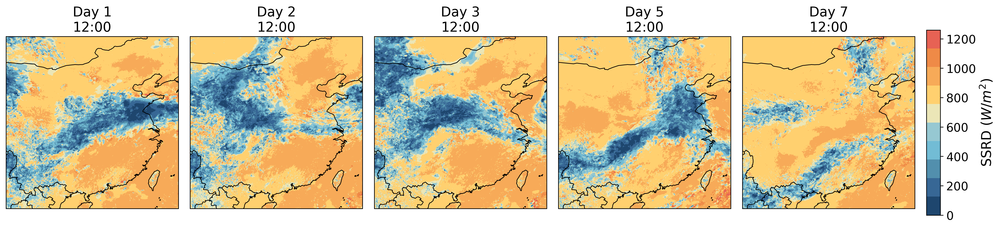

Plotting complete


In [7]:
import os
import xarray as xr
import matplotlib.pyplot as plt
import cartopy.crs as ccrs
import cartopy.feature as cfeature
import numpy as np
import datetime
import matplotlib as mpl
from matplotlib.gridspec import GridSpec
from matplotlib.colors import ListedColormap
import pandas as pd

color_list = ['#1e466e', '#376795', '#528fad', '#72bcd5', '#96c8d2', '#ebe6b7', '#ffd06f', '#f7aa58', '#ef8a47', '#e76254']
custom_cmap = ListedColormap(color_list)

pred_nc_path = './outputs/solar.nc'

lead_time_index = [54, 198, 342, 630, 918]
# Load prediction
with xr.open_dataset(pred_nc_path) as ds:
    stacked_daily_pred = ds['ssrd'].isel(time=0, lead_time=lead_time_index).values
    lons = ds['lon']
    lats = ds['lat']

# output_dir = "./output"
# os.makedirs(output_dir, exist_ok=True)


vmin_ssrd = stacked_daily_pred.min()
vmax_ssrd = stacked_daily_pred.max()

norm_ssrd = mpl.colors.Normalize(vmin=vmin_ssrd, vmax=vmax_ssrd)

# --- Plotting Configuration ---
n_col = 6
fig = plt.figure(figsize=(20, 4), dpi=300)

# Adjust width ratios for 7 columns: cbar1, pred1, gt1, pred2, gt2, error, cbar2
gs = GridSpec(1, n_col, figure=fig, width_ratios=[1, 1, 1, 1, 1, 0.08],
              height_ratios=[1], hspace=0.08, wspace=0.08)

current_day = [1, 2, 3, 5, 7]
# --- Plotting loop ---
for i_col in range(n_col):

    if i_col < n_col - 1:
        ax = fig.add_subplot(gs[0, i_col], projection=ccrs.PlateCarree())

        data = stacked_daily_pred[i_col]
        contour = ax.contourf(lons, lats, data, levels=100, cmap=custom_cmap, transform=ccrs.PlateCarree(), norm=norm_ssrd)
        
        ax.set_title(f"Day {current_day[i_col]}\n12:00", fontsize=16)
        # Common plot features
        ax.add_feature(cfeature.BORDERS, linewidth=0.8, edgecolor='black')
        ax.add_feature(cfeature.COASTLINE, linewidth=0.8)
        ax.set_extent([lons.min(), lons.max(), lats.min(), lats.max()], crs=ccrs.PlateCarree())
        ax.set_xticklabels([])
        ax.set_yticklabels([])
        ax.set_xticks([])
        ax.set_yticks([])

    else:

        cbar_ax = fig.add_subplot(gs[:, i_col])
        sm_ssrd = plt.cm.ScalarMappable(cmap=custom_cmap, norm=norm_ssrd)
        cbar = fig.colorbar(sm_ssrd, cax=cbar_ax, orientation='vertical')
        cbar.set_label('SSRD ($W/m^2$)', fontsize=16)
        cbar_ax.tick_params(labelsize=14)

plt.tight_layout()
plt.show()
print("Plotting complete")

<span style="font-size:18px;">3.2 Inference Using GFS Data</span>

In [1]:
# SPDX-FileCopyrightText: Copyright (c) 2024 NVIDIA CORPORATION & AFFILIATES.
# SPDX-FileCopyrightText: All rights reserved.
# SPDX-License-Identifier: Apache-2.0
#
# Licensed under the Apache License, Version 2.0 (the "License");
# you may not use this file except in compliance with the License.
# You may obtain a copy of the License at
#
# http://www.apache.org/licenses/LICENSE-2.0
#
# Unless required by applicable law or agreed to in writing, software
# distributed under the License is distributed on an "AS IS" BASIS,
# WITHOUT WARRANTIES OR CONDITIONS OF ANY KIND, either express or implied.
# See the License for the specific language governing permissions and
# limitations under the License.

import os
#os.environ["CUDA_VISIBLE_DEVICES"] = "1"
os.environ["EARTH2STUDIO_PACKAGE_TIMEOUT"] = "10000"
import subprocess as sp

os.makedirs("outputs", exist_ok=True)
output_file="./outputs/solar.nc"
from earth2studio.data import GFS, CDS, IFS
from earth2studio.io.netcdf4 import NetCDF4Backend
from earth2studio.models.auto import Package
from earth2studio.models.px import SFNO
from earth2studio.run import deterministic, diagnostic

from fcinterp.interp import ForecastInterpolation
from diagnostic.solarradiation_1h_afno import SolarRadiationAFNO
from collections import OrderedDict
from datetime import datetime
from math import ceil

import numpy as np
import torch
from tqdm import tqdm

from earth2studio.data import DataSource, fetch_data
from earth2studio.io import IOBackend
from earth2studio.models.dx import DiagnosticModel
from earth2studio.models.px import PrognosticModel
from earth2studio.perturbation import Perturbation
from earth2studio.utils.coords import CoordSystem, map_coords
from earth2studio.utils.time import to_time_array
from solarcorrdiff import scall_in_VARIABLES, SolarCorrdiffAll, scall_out_VARIABLES
import matplotlib.pyplot as plt
import copy
# Load the default model package which downloads the check point from NGC
forecast_package = SFNO.load_default_package()
forecast_model = SFNO.load_model(forecast_package)

# Load the interpolation model
interp_package_path = "./fcinterp"
prognostic_model = ForecastInterpolation.load_model(
        Package(interp_package_path, cache=False),
        fc_model=forecast_model,
)

# Load the diagnostic model for ssrd
diagnostic_package_path = "./diagnostic" 
diagnostic_model = SolarRadiationAFNO.load_model(
        Package(diagnostic_package_path, cache=False),
)


# Load the downscaling model for ssrd
solarcorrdiff_package_path = "./solarcorrdiff" 
solarcorrdiff_model = SolarCorrdiffAll.load_model(
        Package(solarcorrdiff_package_path, cache=False),
)

# Create the data source
data = GFS()

# Create the IO handler, store in memory
io = NetCDF4Backend(output_file)

timesteps = 24 * 7  # 10 mins per step
time= ["2025-07-21T18:00:00"]  # start time

def diagnostic_sr(
    time: list[str] | list[datetime] | list[np.datetime64],
    nsteps: int,
    prognostic: PrognosticModel,
    diagnostic: DiagnosticModel,
    solarcorrdiffic: SolarCorrdiffAll,
    data: DataSource,
    io: IOBackend,
    output_coords: CoordSystem = OrderedDict({}),
    device: torch.device | None = None,
) -> IOBackend:
    """Built in diagnostic workflow.
    This workflow creates a determinstic inference pipeline that couples a prognostic
    model with a diagnostic model.

    Parameters
    ----------
    time : list[str] | list[datetime] | list[np.datetime64]
        List of string, datetimes or np.datetime64
    nsteps : int
        Number of forecast steps
    prognostic : PrognosticModel
        Prognostic model
    diagnostic: DiagnosticModel
        Diagnostic model, must be on same coordinate axis as prognostic
    data : DataSource
        Data source
    io : IOBackend
        IO object
    output_coords: CoordSystem, optional
        IO output coordinate system override, by default OrderedDict({})
    device : torch.device, optional
        Device to run inference on, by default None

    Returns
    -------
    IOBackend
        Output IO object
    """
    # sphinx - diagnostic end
    print("Running diagnostic workflow!")
    # Load model onto the device
    device = (
        device
        if device is not None
        else torch.device("cuda" if torch.cuda.is_available() else "cpu")
    )
    print(f"Inference device: {device}")
    prognostic = prognostic.to(device)
    diagnostic = diagnostic.to(device)
    solarcorrdiffic = solarcorrdiffic.to(device)
    # Fetch data from data source and load onto device
    prognositc_ic = prognostic.input_coords()
    diagnostic_ic = diagnostic.input_coords()
    time = to_time_array(time)

    x, coords = fetch_data(
        source=data,
        time=time,
        variable=prognositc_ic["variable"],
        lead_time=prognositc_ic["lead_time"],
        device=device,
    )
    
    print(f"Fetched data from {data.__class__.__name__}")

    if output_coords:
        total_coords = output_coords
    else:
        total_coords = solarcorrdiffic.get_total_coord(time, nsteps)

    io.add_array(total_coords, "ssrd")

    # Map lat and lon if needed
    x, coords = map_coords(x, coords, prognositc_ic)
    
    # Create prognostic iterator
    model = prognostic.create_iterator(x, coords)

    print("Inference starting!")
    with tqdm(total=nsteps + 1, desc="Running inference") as pbar:
        for step, (x, coords) in enumerate(model):
            print("intime", time)
            print("protime", coords["time"])
            
            pro_out, pro_out_coord = copy.deepcopy(x), copy.deepcopy(coords) # record the output of pro model
            
            x, coords = map_coords(x, coords, diagnostic_ic)
            x, coords = diagnostic(x, coords)

            print("diatime", coords["time"])

            dia_out, dia_out_coord = copy.deepcopy(x), copy.deepcopy(coords)

            x, coords = solarcorrdiffic(pro_out, pro_out_coord, dia_out, dia_out_coord, True, step)
            
            if x is not None:
                x, coords = map_coords(x, coords, output_coords)
                coords.pop("variable")
                io.write(x, coords, "ssrd")

            pbar.update(1)
            if step == nsteps:
                break

    print("Inference complete")
    return io

def get_gpu_memory():
    command = "nvidia-smi --query-gpu=memory.free --format=csv"
    memory_free_info = sp.check_output(command.split()).decode('ascii').split('\n')[:-1][1:]
    memory_free_values = [int(x.split()[0]) for i, x in enumerate(memory_free_info)]
    return memory_free_values

# run inference
with torch.no_grad():
    diagnostic_sr(time, timesteps, prognostic_model, diagnostic_model, solarcorrdiff_model, data, io)

/root/miniconda3/envs/solar/lib/python3.10/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm
/root/miniconda3/envs/solar/lib/python3.10/site-packages/earth2studio/data/gfs.py:120: RuntimeWarning: coroutine 'GFS._async_init' was never awaited
  self.fs = None


2025-09-03 06:45:18.758 | WARNING  | earth2studio.models.auto.ngc:__init__:131 - Using NGC guest mode, which may fail due to unauthorized access. Consider using a valid NGC API key and org
Running diagnostic workflow!
Inference device: cuda


Fetching GFS data:   0%|          | 0/73 [00:00<?, ?it/s]

2025-09-03 06:45:54.786 | DEBUG    | earth2studio.data.gfs:fetch_array:380 - Fetching GFS grib file: noaa-gfs-bdp-pds/gfs.20250721/18/atmos/gfs.t18z.pgrb2.0p25.f000 145338958-640201
2025-09-03 06:45:54.790 | DEBUG    | earth2studio.data.gfs:fetch_array:380 - Fetching GFS grib file: noaa-gfs-bdp-pds/gfs.20250721/18/atmos/gfs.t18z.pgrb2.0p25.f000 280399144-919378
2025-09-03 06:45:54.792 | DEBUG    | earth2studio.data.gfs:fetch_array:380 - Fetching GFS grib file: noaa-gfs-bdp-pds/gfs.20250721/18/atmos/gfs.t18z.pgrb2.0p25.f000 357306753-1276441
2025-09-03 06:45:54.795 | DEBUG    | earth2studio.data.gfs:fetch_array:380 - Fetching GFS grib file: noaa-gfs-bdp-pds/gfs.20250721/18/atmos/gfs.t18z.pgrb2.0p25.f000 231850449-728215
2025-09-03 06:45:54.798 | DEBUG    | earth2studio.data.gfs:fetch_array:380 - Fetching GFS grib file: noaa-gfs-bdp-pds/gfs.20250721/18/atmos/gfs.t18z.pgrb2.0p25.f000 166519887-742251
2025-09-03 06:45:54.800 | DEBUG    | earth2studio.data.gfs:fetch_array:380 - Fetching GFS

Fetching GFS data: 100%|██████████| 73/73 [00:06<00:00, 10.91it/s]


Fetched data from GFS
Inference starting!


Running inference:   0%|          | 0/169 [00:00<?, ?it/s]

intime ['2025-07-21T18:00:00.000000000']
protime ['2025-07-21T18:00:00.000000000']
2025-07-21 18:00:00


Running inference:   1%|          | 1/169 [00:00<01:35,  1.76it/s]

diatime ['2025-07-21T18:00:00.000000000']
intime ['2025-07-21T18:00:00.000000000']
protime ['2025-07-21T18:00:00.000000000']
2025-07-21 19:00:00
diatime ['2025-07-21T18:00:00.000000000']



Running inference:   1%|          | 2/169 [00:16<26:55,  9.67s/it]

intime ['2025-07-21T18:00:00.000000000']
protime ['2025-07-21T18:00:00.000000000']
2025-07-21 20:00:00
diatime ['2025-07-21T18:00:00.000000000']



Running inference:   2%|▏         | 3/169 [00:30<31:50, 11.51s/it]

intime ['2025-07-21T18:00:00.000000000']
protime ['2025-07-21T18:00:00.000000000']
2025-07-21 21:00:00
diatime ['2025-07-21T18:00:00.000000000']



Running inference:   2%|▏         | 4/169 [00:44<34:02, 12.38s/it]

intime ['2025-07-21T18:00:00.000000000']
protime ['2025-07-21T18:00:00.000000000']
2025-07-21 22:00:00
diatime ['2025-07-21T18:00:00.000000000']



Running inference:   3%|▎         | 5/169 [00:57<35:13, 12.89s/it]

intime ['2025-07-21T18:00:00.000000000']
protime ['2025-07-21T18:00:00.000000000']
2025-07-21 23:00:00
diatime ['2025-07-21T18:00:00.000000000']



Running inference:   4%|▎         | 6/169 [01:11<35:50, 13.20s/it]

intime ['2025-07-21T18:00:00.000000000']
protime ['2025-07-21T18:00:00.000000000']
2025-07-22 00:00:00
diatime ['2025-07-21T18:00:00.000000000']



Running inference:   4%|▍         | 7/169 [01:24<35:25, 13.12s/it]

intime ['2025-07-21T18:00:00.000000000']
protime ['2025-07-21T18:00:00.000000000']
2025-07-22 01:00:00
diatime ['2025-07-21T18:00:00.000000000']



Running inference:   5%|▍         | 8/169 [01:38<36:03, 13.44s/it]

intime ['2025-07-21T18:00:00.000000000']
protime ['2025-07-21T18:00:00.000000000']
2025-07-22 02:00:00
diatime ['2025-07-21T18:00:00.000000000']



Running inference:   5%|▌         | 9/169 [01:52<36:09, 13.56s/it]

intime ['2025-07-21T18:00:00.000000000']
protime ['2025-07-21T18:00:00.000000000']
2025-07-22 03:00:00
diatime ['2025-07-21T18:00:00.000000000']



Running inference:   6%|▌         | 10/169 [02:06<36:14, 13.68s/it]

intime ['2025-07-21T18:00:00.000000000']
protime ['2025-07-21T18:00:00.000000000']
2025-07-22 04:00:00
diatime ['2025-07-21T18:00:00.000000000']



Running inference:   7%|▋         | 11/169 [02:20<36:21, 13.81s/it]

intime ['2025-07-21T18:00:00.000000000']
protime ['2025-07-21T18:00:00.000000000']
2025-07-22 05:00:00
diatime ['2025-07-21T18:00:00.000000000']



Running inference:   7%|▋         | 12/169 [02:34<36:11, 13.83s/it]

intime ['2025-07-21T18:00:00.000000000']
protime ['2025-07-21T18:00:00.000000000']
2025-07-22 06:00:00
diatime ['2025-07-21T18:00:00.000000000']



Running inference:   8%|▊         | 13/169 [02:47<35:20, 13.59s/it]

intime ['2025-07-21T18:00:00.000000000']
protime ['2025-07-21T18:00:00.000000000']
2025-07-22 07:00:00
diatime ['2025-07-21T18:00:00.000000000']



Running inference:   8%|▊         | 14/169 [03:01<35:34, 13.77s/it]

intime ['2025-07-21T18:00:00.000000000']
protime ['2025-07-21T18:00:00.000000000']
2025-07-22 08:00:00
diatime ['2025-07-21T18:00:00.000000000']



Running inference:   9%|▉         | 15/169 [03:15<35:25, 13.80s/it]

intime ['2025-07-21T18:00:00.000000000']
protime ['2025-07-21T18:00:00.000000000']
2025-07-22 09:00:00
diatime ['2025-07-21T18:00:00.000000000']



Running inference:   9%|▉         | 16/169 [03:29<35:14, 13.82s/it]

intime ['2025-07-21T18:00:00.000000000']
protime ['2025-07-21T18:00:00.000000000']
2025-07-22 10:00:00
diatime ['2025-07-21T18:00:00.000000000']



Running inference:  10%|█         | 17/169 [03:43<35:03, 13.84s/it]

intime ['2025-07-21T18:00:00.000000000']
protime ['2025-07-21T18:00:00.000000000']
2025-07-22 11:00:00
diatime ['2025-07-21T18:00:00.000000000']



Running inference:  11%|█         | 18/169 [03:57<34:48, 13.83s/it]

intime ['2025-07-21T18:00:00.000000000']
protime ['2025-07-21T18:00:00.000000000']
2025-07-22 12:00:00
diatime ['2025-07-21T18:00:00.000000000']



Running inference:  11%|█         | 19/169 [04:10<33:53, 13.56s/it]

intime ['2025-07-21T18:00:00.000000000']
protime ['2025-07-21T18:00:00.000000000']
2025-07-22 13:00:00
diatime ['2025-07-21T18:00:00.000000000']



Running inference:  12%|█▏        | 20/169 [04:24<33:59, 13.69s/it]

intime ['2025-07-21T18:00:00.000000000']
protime ['2025-07-21T18:00:00.000000000']
2025-07-22 14:00:00
diatime ['2025-07-21T18:00:00.000000000']



Running inference:  12%|█▏        | 21/169 [04:38<34:00, 13.79s/it]

intime ['2025-07-21T18:00:00.000000000']
protime ['2025-07-21T18:00:00.000000000']
2025-07-22 15:00:00
diatime ['2025-07-21T18:00:00.000000000']



Running inference:  13%|█▎        | 22/169 [04:51<33:42, 13.76s/it]

intime ['2025-07-21T18:00:00.000000000']
protime ['2025-07-21T18:00:00.000000000']
2025-07-22 16:00:00
diatime ['2025-07-21T18:00:00.000000000']



Running inference:  14%|█▎        | 23/169 [05:05<33:26, 13.75s/it]

intime ['2025-07-21T18:00:00.000000000']
protime ['2025-07-21T18:00:00.000000000']
2025-07-22 17:00:00
diatime ['2025-07-21T18:00:00.000000000']



Running inference:  14%|█▍        | 24/169 [05:19<33:12, 13.74s/it]

intime ['2025-07-21T18:00:00.000000000']
protime ['2025-07-21T18:00:00.000000000']
2025-07-22 18:00:00
diatime ['2025-07-21T18:00:00.000000000']



Running inference:  15%|█▍        | 25/169 [05:32<32:22, 13.49s/it]

intime ['2025-07-21T18:00:00.000000000']
protime ['2025-07-21T18:00:00.000000000']
2025-07-22 19:00:00
diatime ['2025-07-21T18:00:00.000000000']



Running inference:  15%|█▌        | 26/169 [05:46<32:31, 13.65s/it]

intime ['2025-07-21T18:00:00.000000000']
protime ['2025-07-21T18:00:00.000000000']
2025-07-22 20:00:00
diatime ['2025-07-21T18:00:00.000000000']



Running inference:  16%|█▌        | 27/169 [05:59<32:19, 13.66s/it]

intime ['2025-07-21T18:00:00.000000000']
protime ['2025-07-21T18:00:00.000000000']
2025-07-22 21:00:00
diatime ['2025-07-21T18:00:00.000000000']



Running inference:  17%|█▋        | 28/169 [06:13<32:06, 13.67s/it]

intime ['2025-07-21T18:00:00.000000000']
protime ['2025-07-21T18:00:00.000000000']
2025-07-22 22:00:00
diatime ['2025-07-21T18:00:00.000000000']



Running inference:  17%|█▋        | 29/169 [06:27<31:55, 13.68s/it]

intime ['2025-07-21T18:00:00.000000000']
protime ['2025-07-21T18:00:00.000000000']
2025-07-22 23:00:00
diatime ['2025-07-21T18:00:00.000000000']



Running inference:  18%|█▊        | 30/169 [06:40<31:46, 13.71s/it]

intime ['2025-07-21T18:00:00.000000000']
protime ['2025-07-21T18:00:00.000000000']
2025-07-23 00:00:00
diatime ['2025-07-21T18:00:00.000000000']



Running inference:  18%|█▊        | 31/169 [06:53<31:01, 13.49s/it]

intime ['2025-07-21T18:00:00.000000000']
protime ['2025-07-21T18:00:00.000000000']
2025-07-23 01:00:00
diatime ['2025-07-21T18:00:00.000000000']



Running inference:  19%|█▉        | 32/169 [07:08<31:14, 13.69s/it]

intime ['2025-07-21T18:00:00.000000000']
protime ['2025-07-21T18:00:00.000000000']
2025-07-23 02:00:00
diatime ['2025-07-21T18:00:00.000000000']



Running inference:  20%|█▉        | 33/169 [07:21<31:09, 13.74s/it]

intime ['2025-07-21T18:00:00.000000000']
protime ['2025-07-21T18:00:00.000000000']
2025-07-23 03:00:00
diatime ['2025-07-21T18:00:00.000000000']



Running inference:  20%|██        | 34/169 [07:36<31:18, 13.92s/it]

intime ['2025-07-21T18:00:00.000000000']
protime ['2025-07-21T18:00:00.000000000']
2025-07-23 04:00:00
diatime ['2025-07-21T18:00:00.000000000']



Running inference:  21%|██        | 35/169 [07:50<31:02, 13.90s/it]

intime ['2025-07-21T18:00:00.000000000']
protime ['2025-07-21T18:00:00.000000000']
2025-07-23 05:00:00
diatime ['2025-07-21T18:00:00.000000000']



Running inference:  21%|██▏       | 36/169 [08:04<30:48, 13.90s/it]

intime ['2025-07-21T18:00:00.000000000']
protime ['2025-07-21T18:00:00.000000000']
2025-07-23 06:00:00
diatime ['2025-07-21T18:00:00.000000000']



Running inference:  22%|██▏       | 37/169 [08:17<29:58, 13.62s/it]

intime ['2025-07-21T18:00:00.000000000']
protime ['2025-07-21T18:00:00.000000000']
2025-07-23 07:00:00
diatime ['2025-07-21T18:00:00.000000000']



Running inference:  22%|██▏       | 38/169 [08:31<30:06, 13.79s/it]

intime ['2025-07-21T18:00:00.000000000']
protime ['2025-07-21T18:00:00.000000000']
2025-07-23 08:00:00
diatime ['2025-07-21T18:00:00.000000000']



Running inference:  23%|██▎       | 39/169 [08:45<29:55, 13.81s/it]

intime ['2025-07-21T18:00:00.000000000']
protime ['2025-07-21T18:00:00.000000000']
2025-07-23 09:00:00
diatime ['2025-07-21T18:00:00.000000000']



Running inference:  24%|██▎       | 40/169 [08:58<29:43, 13.82s/it]

intime ['2025-07-21T18:00:00.000000000']
protime ['2025-07-21T18:00:00.000000000']
2025-07-23 10:00:00
diatime ['2025-07-21T18:00:00.000000000']



Running inference:  24%|██▍       | 41/169 [09:12<29:31, 13.84s/it]

intime ['2025-07-21T18:00:00.000000000']
protime ['2025-07-21T18:00:00.000000000']
2025-07-23 11:00:00
diatime ['2025-07-21T18:00:00.000000000']



Running inference:  25%|██▍       | 42/169 [09:26<29:17, 13.84s/it]

intime ['2025-07-21T18:00:00.000000000']
protime ['2025-07-21T18:00:00.000000000']
2025-07-23 12:00:00
diatime ['2025-07-21T18:00:00.000000000']



Running inference:  25%|██▌       | 43/169 [09:39<28:27, 13.55s/it]

intime ['2025-07-21T18:00:00.000000000']
protime ['2025-07-21T18:00:00.000000000']
2025-07-23 13:00:00
diatime ['2025-07-21T18:00:00.000000000']



Running inference:  26%|██▌       | 44/169 [09:53<28:29, 13.67s/it]

intime ['2025-07-21T18:00:00.000000000']
protime ['2025-07-21T18:00:00.000000000']
2025-07-23 14:00:00
diatime ['2025-07-21T18:00:00.000000000']



Running inference:  27%|██▋       | 45/169 [10:07<28:17, 13.69s/it]

intime ['2025-07-21T18:00:00.000000000']
protime ['2025-07-21T18:00:00.000000000']
2025-07-23 15:00:00
diatime ['2025-07-21T18:00:00.000000000']



Running inference:  27%|██▋       | 46/169 [10:20<28:02, 13.68s/it]

intime ['2025-07-21T18:00:00.000000000']
protime ['2025-07-21T18:00:00.000000000']
2025-07-23 16:00:00
diatime ['2025-07-21T18:00:00.000000000']



Running inference:  28%|██▊       | 47/169 [10:34<27:50, 13.70s/it]

intime ['2025-07-21T18:00:00.000000000']
protime ['2025-07-21T18:00:00.000000000']
2025-07-23 17:00:00
diatime ['2025-07-21T18:00:00.000000000']



Running inference:  28%|██▊       | 48/169 [10:48<27:36, 13.69s/it]

intime ['2025-07-21T18:00:00.000000000']
protime ['2025-07-21T18:00:00.000000000']
2025-07-23 18:00:00
diatime ['2025-07-21T18:00:00.000000000']



Running inference:  29%|██▉       | 49/169 [11:01<26:51, 13.43s/it]

intime ['2025-07-21T18:00:00.000000000']
protime ['2025-07-21T18:00:00.000000000']
2025-07-23 19:00:00
diatime ['2025-07-21T18:00:00.000000000']



Running inference:  30%|██▉       | 50/169 [11:15<27:22, 13.80s/it]

intime ['2025-07-21T18:00:00.000000000']
protime ['2025-07-21T18:00:00.000000000']
2025-07-23 20:00:00
diatime ['2025-07-21T18:00:00.000000000']



Running inference:  30%|███       | 51/169 [11:29<27:05, 13.77s/it]

intime ['2025-07-21T18:00:00.000000000']
protime ['2025-07-21T18:00:00.000000000']
2025-07-23 21:00:00
diatime ['2025-07-21T18:00:00.000000000']



Running inference:  31%|███       | 52/169 [11:43<26:48, 13.75s/it]

intime ['2025-07-21T18:00:00.000000000']
protime ['2025-07-21T18:00:00.000000000']
2025-07-23 22:00:00
diatime ['2025-07-21T18:00:00.000000000']



Running inference:  31%|███▏      | 53/169 [11:56<26:37, 13.77s/it]

intime ['2025-07-21T18:00:00.000000000']
protime ['2025-07-21T18:00:00.000000000']
2025-07-23 23:00:00
diatime ['2025-07-21T18:00:00.000000000']



Running inference:  32%|███▏      | 54/169 [12:10<26:25, 13.79s/it]

intime ['2025-07-21T18:00:00.000000000']
protime ['2025-07-21T18:00:00.000000000']
2025-07-24 00:00:00
diatime ['2025-07-21T18:00:00.000000000']



Running inference:  33%|███▎      | 55/169 [12:23<25:49, 13.59s/it]

intime ['2025-07-21T18:00:00.000000000']
protime ['2025-07-21T18:00:00.000000000']
2025-07-24 01:00:00
diatime ['2025-07-21T18:00:00.000000000']



Running inference:  33%|███▎      | 56/169 [12:38<25:56, 13.78s/it]

intime ['2025-07-21T18:00:00.000000000']
protime ['2025-07-21T18:00:00.000000000']
2025-07-24 02:00:00
diatime ['2025-07-21T18:00:00.000000000']



Running inference:  34%|███▎      | 57/169 [12:52<25:49, 13.84s/it]

intime ['2025-07-21T18:00:00.000000000']
protime ['2025-07-21T18:00:00.000000000']
2025-07-24 03:00:00
diatime ['2025-07-21T18:00:00.000000000']



Running inference:  34%|███▍      | 58/169 [13:06<25:39, 13.87s/it]

intime ['2025-07-21T18:00:00.000000000']
protime ['2025-07-21T18:00:00.000000000']
2025-07-24 04:00:00
diatime ['2025-07-21T18:00:00.000000000']



Running inference:  35%|███▍      | 59/169 [13:19<25:28, 13.89s/it]

intime ['2025-07-21T18:00:00.000000000']
protime ['2025-07-21T18:00:00.000000000']
2025-07-24 05:00:00
diatime ['2025-07-21T18:00:00.000000000']



Running inference:  36%|███▌      | 60/169 [13:33<25:15, 13.90s/it]

intime ['2025-07-21T18:00:00.000000000']
protime ['2025-07-21T18:00:00.000000000']
2025-07-24 06:00:00
diatime ['2025-07-21T18:00:00.000000000']



Running inference:  36%|███▌      | 61/169 [13:46<24:32, 13.64s/it]

intime ['2025-07-21T18:00:00.000000000']
protime ['2025-07-21T18:00:00.000000000']
2025-07-24 07:00:00
diatime ['2025-07-21T18:00:00.000000000']



Running inference:  37%|███▋      | 62/169 [14:01<24:38, 13.81s/it]

intime ['2025-07-21T18:00:00.000000000']
protime ['2025-07-21T18:00:00.000000000']
2025-07-24 08:00:00
diatime ['2025-07-21T18:00:00.000000000']



Running inference:  37%|███▋      | 63/169 [14:15<24:26, 13.83s/it]

intime ['2025-07-21T18:00:00.000000000']
protime ['2025-07-21T18:00:00.000000000']
2025-07-24 09:00:00
diatime ['2025-07-21T18:00:00.000000000']



Running inference:  38%|███▊      | 64/169 [14:28<24:12, 13.83s/it]

intime ['2025-07-21T18:00:00.000000000']
protime ['2025-07-21T18:00:00.000000000']
2025-07-24 10:00:00
diatime ['2025-07-21T18:00:00.000000000']



Running inference:  38%|███▊      | 65/169 [14:42<23:57, 13.82s/it]

intime ['2025-07-21T18:00:00.000000000']
protime ['2025-07-21T18:00:00.000000000']
2025-07-24 11:00:00
diatime ['2025-07-21T18:00:00.000000000']



Running inference:  39%|███▉      | 66/169 [14:56<23:45, 13.84s/it]

intime ['2025-07-21T18:00:00.000000000']
protime ['2025-07-21T18:00:00.000000000']
2025-07-24 12:00:00
diatime ['2025-07-21T18:00:00.000000000']



Running inference:  40%|███▉      | 67/169 [15:09<23:02, 13.56s/it]

intime ['2025-07-21T18:00:00.000000000']
protime ['2025-07-21T18:00:00.000000000']
2025-07-24 13:00:00
diatime ['2025-07-21T18:00:00.000000000']



Running inference:  40%|████      | 68/169 [15:23<23:02, 13.69s/it]

intime ['2025-07-21T18:00:00.000000000']
protime ['2025-07-21T18:00:00.000000000']
2025-07-24 14:00:00
diatime ['2025-07-21T18:00:00.000000000']



Running inference:  41%|████      | 69/169 [15:37<22:47, 13.68s/it]

intime ['2025-07-21T18:00:00.000000000']
protime ['2025-07-21T18:00:00.000000000']
2025-07-24 15:00:00
diatime ['2025-07-21T18:00:00.000000000']



Running inference:  41%|████▏     | 70/169 [15:51<23:01, 13.96s/it]

intime ['2025-07-21T18:00:00.000000000']
protime ['2025-07-21T18:00:00.000000000']
2025-07-24 16:00:00
diatime ['2025-07-21T18:00:00.000000000']



Running inference:  42%|████▏     | 71/169 [16:05<22:41, 13.90s/it]

intime ['2025-07-21T18:00:00.000000000']
protime ['2025-07-21T18:00:00.000000000']
2025-07-24 17:00:00
diatime ['2025-07-21T18:00:00.000000000']



Running inference:  43%|████▎     | 72/169 [16:19<22:21, 13.83s/it]

intime ['2025-07-21T18:00:00.000000000']
protime ['2025-07-21T18:00:00.000000000']
2025-07-24 18:00:00
diatime ['2025-07-21T18:00:00.000000000']



Running inference:  43%|████▎     | 73/169 [16:32<21:43, 13.58s/it]

intime ['2025-07-21T18:00:00.000000000']
protime ['2025-07-21T18:00:00.000000000']
2025-07-24 19:00:00
diatime ['2025-07-21T18:00:00.000000000']



Running inference:  44%|████▍     | 74/169 [16:46<21:41, 13.70s/it]

intime ['2025-07-21T18:00:00.000000000']
protime ['2025-07-21T18:00:00.000000000']
2025-07-24 20:00:00
diatime ['2025-07-21T18:00:00.000000000']



Running inference:  44%|████▍     | 75/169 [16:59<21:29, 13.72s/it]

intime ['2025-07-21T18:00:00.000000000']
protime ['2025-07-21T18:00:00.000000000']
2025-07-24 21:00:00
diatime ['2025-07-21T18:00:00.000000000']



Running inference:  45%|████▍     | 76/169 [17:13<21:14, 13.71s/it]

intime ['2025-07-21T18:00:00.000000000']
protime ['2025-07-21T18:00:00.000000000']
2025-07-24 22:00:00
diatime ['2025-07-21T18:00:00.000000000']



Running inference:  46%|████▌     | 77/169 [17:27<21:02, 13.72s/it]

intime ['2025-07-21T18:00:00.000000000']
protime ['2025-07-21T18:00:00.000000000']
2025-07-24 23:00:00
diatime ['2025-07-21T18:00:00.000000000']



Running inference:  46%|████▌     | 78/169 [17:41<20:49, 13.73s/it]

intime ['2025-07-21T18:00:00.000000000']
protime ['2025-07-21T18:00:00.000000000']
2025-07-25 00:00:00
diatime ['2025-07-21T18:00:00.000000000']



Running inference:  47%|████▋     | 79/169 [17:54<20:14, 13.50s/it]

intime ['2025-07-21T18:00:00.000000000']
protime ['2025-07-21T18:00:00.000000000']
2025-07-25 01:00:00
diatime ['2025-07-21T18:00:00.000000000']



Running inference:  47%|████▋     | 80/169 [18:08<20:18, 13.69s/it]

intime ['2025-07-21T18:00:00.000000000']
protime ['2025-07-21T18:00:00.000000000']
2025-07-25 02:00:00
diatime ['2025-07-21T18:00:00.000000000']



Running inference:  48%|████▊     | 81/169 [18:22<20:11, 13.77s/it]

intime ['2025-07-21T18:00:00.000000000']
protime ['2025-07-21T18:00:00.000000000']
2025-07-25 03:00:00
diatime ['2025-07-21T18:00:00.000000000']



Running inference:  49%|████▊     | 82/169 [18:36<20:03, 13.83s/it]

intime ['2025-07-21T18:00:00.000000000']
protime ['2025-07-21T18:00:00.000000000']
2025-07-25 04:00:00
diatime ['2025-07-21T18:00:00.000000000']



Running inference:  49%|████▉     | 83/169 [18:49<19:50, 13.85s/it]

intime ['2025-07-21T18:00:00.000000000']
protime ['2025-07-21T18:00:00.000000000']
2025-07-25 05:00:00
diatime ['2025-07-21T18:00:00.000000000']



Running inference:  50%|████▉     | 84/169 [19:03<19:37, 13.86s/it]

intime ['2025-07-21T18:00:00.000000000']
protime ['2025-07-21T18:00:00.000000000']
2025-07-25 06:00:00
diatime ['2025-07-21T18:00:00.000000000']



Running inference:  50%|█████     | 85/169 [19:16<19:02, 13.60s/it]

intime ['2025-07-21T18:00:00.000000000']
protime ['2025-07-21T18:00:00.000000000']
2025-07-25 07:00:00
diatime ['2025-07-21T18:00:00.000000000']



Running inference:  51%|█████     | 86/169 [19:31<19:04, 13.79s/it]

intime ['2025-07-21T18:00:00.000000000']
protime ['2025-07-21T18:00:00.000000000']
2025-07-25 08:00:00
diatime ['2025-07-21T18:00:00.000000000']



Running inference:  51%|█████▏    | 87/169 [19:44<18:53, 13.82s/it]

intime ['2025-07-21T18:00:00.000000000']
protime ['2025-07-21T18:00:00.000000000']
2025-07-25 09:00:00
diatime ['2025-07-21T18:00:00.000000000']



Running inference:  52%|█████▏    | 88/169 [19:58<18:40, 13.84s/it]

intime ['2025-07-21T18:00:00.000000000']
protime ['2025-07-21T18:00:00.000000000']
2025-07-25 10:00:00
diatime ['2025-07-21T18:00:00.000000000']



Running inference:  53%|█████▎    | 89/169 [20:12<18:27, 13.84s/it]

intime ['2025-07-21T18:00:00.000000000']
protime ['2025-07-21T18:00:00.000000000']
2025-07-25 11:00:00
diatime ['2025-07-21T18:00:00.000000000']



Running inference:  53%|█████▎    | 90/169 [20:26<18:13, 13.84s/it]

intime ['2025-07-21T18:00:00.000000000']
protime ['2025-07-21T18:00:00.000000000']
2025-07-25 12:00:00
diatime ['2025-07-21T18:00:00.000000000']



Running inference:  54%|█████▍    | 91/169 [20:39<17:37, 13.55s/it]

intime ['2025-07-21T18:00:00.000000000']
protime ['2025-07-21T18:00:00.000000000']
2025-07-25 13:00:00
diatime ['2025-07-21T18:00:00.000000000']



Running inference:  54%|█████▍    | 92/169 [20:53<17:34, 13.69s/it]

intime ['2025-07-21T18:00:00.000000000']
protime ['2025-07-21T18:00:00.000000000']
2025-07-25 14:00:00
diatime ['2025-07-21T18:00:00.000000000']



Running inference:  55%|█████▌    | 93/169 [21:07<17:20, 13.70s/it]

intime ['2025-07-21T18:00:00.000000000']
protime ['2025-07-21T18:00:00.000000000']
2025-07-25 15:00:00
diatime ['2025-07-21T18:00:00.000000000']



Running inference:  56%|█████▌    | 94/169 [21:20<17:06, 13.69s/it]

intime ['2025-07-21T18:00:00.000000000']
protime ['2025-07-21T18:00:00.000000000']
2025-07-25 16:00:00
diatime ['2025-07-21T18:00:00.000000000']



Running inference:  56%|█████▌    | 95/169 [21:35<17:16, 14.01s/it]

intime ['2025-07-21T18:00:00.000000000']
protime ['2025-07-21T18:00:00.000000000']
2025-07-25 17:00:00
diatime ['2025-07-21T18:00:00.000000000']



Running inference:  57%|█████▋    | 96/169 [21:49<16:56, 13.92s/it]

intime ['2025-07-21T18:00:00.000000000']
protime ['2025-07-21T18:00:00.000000000']
2025-07-25 18:00:00
diatime ['2025-07-21T18:00:00.000000000']



Running inference:  57%|█████▋    | 97/169 [22:02<16:31, 13.77s/it]

intime ['2025-07-21T18:00:00.000000000']
protime ['2025-07-21T18:00:00.000000000']
2025-07-25 19:00:00
diatime ['2025-07-21T18:00:00.000000000']



Running inference:  58%|█████▊    | 98/169 [22:16<16:22, 13.83s/it]

intime ['2025-07-21T18:00:00.000000000']
protime ['2025-07-21T18:00:00.000000000']
2025-07-25 20:00:00
diatime ['2025-07-21T18:00:00.000000000']



Running inference:  59%|█████▊    | 99/169 [22:30<16:04, 13.79s/it]

intime ['2025-07-21T18:00:00.000000000']
protime ['2025-07-21T18:00:00.000000000']
2025-07-25 21:00:00
diatime ['2025-07-21T18:00:00.000000000']



Running inference:  59%|█████▉    | 100/169 [22:44<15:48, 13.75s/it]

intime ['2025-07-21T18:00:00.000000000']
protime ['2025-07-21T18:00:00.000000000']
2025-07-25 22:00:00
diatime ['2025-07-21T18:00:00.000000000']



Running inference:  60%|█████▉    | 101/169 [22:57<15:35, 13.76s/it]

intime ['2025-07-21T18:00:00.000000000']
protime ['2025-07-21T18:00:00.000000000']
2025-07-25 23:00:00
diatime ['2025-07-21T18:00:00.000000000']



Running inference:  60%|██████    | 102/169 [23:11<15:26, 13.82s/it]

intime ['2025-07-21T18:00:00.000000000']
protime ['2025-07-21T18:00:00.000000000']
2025-07-26 00:00:00
diatime ['2025-07-21T18:00:00.000000000']



Running inference:  61%|██████    | 103/169 [23:24<14:56, 13.59s/it]

intime ['2025-07-21T18:00:00.000000000']
protime ['2025-07-21T18:00:00.000000000']
2025-07-26 01:00:00
diatime ['2025-07-21T18:00:00.000000000']



Running inference:  62%|██████▏   | 104/169 [23:39<14:58, 13.82s/it]

intime ['2025-07-21T18:00:00.000000000']
protime ['2025-07-21T18:00:00.000000000']
2025-07-26 02:00:00
diatime ['2025-07-21T18:00:00.000000000']



Running inference:  62%|██████▏   | 105/169 [23:53<14:46, 13.85s/it]

intime ['2025-07-21T18:00:00.000000000']
protime ['2025-07-21T18:00:00.000000000']
2025-07-26 03:00:00
diatime ['2025-07-21T18:00:00.000000000']



Running inference:  63%|██████▎   | 106/169 [24:07<14:34, 13.88s/it]

intime ['2025-07-21T18:00:00.000000000']
protime ['2025-07-21T18:00:00.000000000']
2025-07-26 04:00:00
diatime ['2025-07-21T18:00:00.000000000']



Running inference:  63%|██████▎   | 107/169 [24:20<14:20, 13.89s/it]

intime ['2025-07-21T18:00:00.000000000']
protime ['2025-07-21T18:00:00.000000000']
2025-07-26 05:00:00
diatime ['2025-07-21T18:00:00.000000000']



Running inference:  64%|██████▍   | 108/169 [24:34<14:08, 13.91s/it]

intime ['2025-07-21T18:00:00.000000000']
protime ['2025-07-21T18:00:00.000000000']
2025-07-26 06:00:00
diatime ['2025-07-21T18:00:00.000000000']



Running inference:  64%|██████▍   | 109/169 [24:47<13:38, 13.64s/it]

intime ['2025-07-21T18:00:00.000000000']
protime ['2025-07-21T18:00:00.000000000']
2025-07-26 07:00:00
diatime ['2025-07-21T18:00:00.000000000']



Running inference:  65%|██████▌   | 110/169 [25:02<13:33, 13.80s/it]

intime ['2025-07-21T18:00:00.000000000']
protime ['2025-07-21T18:00:00.000000000']
2025-07-26 08:00:00
diatime ['2025-07-21T18:00:00.000000000']



Running inference:  66%|██████▌   | 111/169 [25:15<13:22, 13.83s/it]

intime ['2025-07-21T18:00:00.000000000']
protime ['2025-07-21T18:00:00.000000000']
2025-07-26 09:00:00
diatime ['2025-07-21T18:00:00.000000000']



Running inference:  66%|██████▋   | 112/169 [25:29<13:09, 13.85s/it]

intime ['2025-07-21T18:00:00.000000000']
protime ['2025-07-21T18:00:00.000000000']
2025-07-26 10:00:00
diatime ['2025-07-21T18:00:00.000000000']



Running inference:  67%|██████▋   | 113/169 [25:43<12:58, 13.90s/it]

intime ['2025-07-21T18:00:00.000000000']
protime ['2025-07-21T18:00:00.000000000']
2025-07-26 11:00:00
diatime ['2025-07-21T18:00:00.000000000']



Running inference:  67%|██████▋   | 114/169 [25:57<12:43, 13.87s/it]

intime ['2025-07-21T18:00:00.000000000']
protime ['2025-07-21T18:00:00.000000000']
2025-07-26 12:00:00
diatime ['2025-07-21T18:00:00.000000000']



Running inference:  68%|██████▊   | 115/169 [26:10<12:13, 13.58s/it]

intime ['2025-07-21T18:00:00.000000000']
protime ['2025-07-21T18:00:00.000000000']
2025-07-26 13:00:00
diatime ['2025-07-21T18:00:00.000000000']



Running inference:  69%|██████▊   | 116/169 [26:24<12:06, 13.70s/it]

intime ['2025-07-21T18:00:00.000000000']
protime ['2025-07-21T18:00:00.000000000']
2025-07-26 14:00:00
diatime ['2025-07-21T18:00:00.000000000']



Running inference:  69%|██████▉   | 117/169 [26:38<11:52, 13.70s/it]

intime ['2025-07-21T18:00:00.000000000']
protime ['2025-07-21T18:00:00.000000000']
2025-07-26 15:00:00
diatime ['2025-07-21T18:00:00.000000000']



Running inference:  70%|██████▉   | 118/169 [26:51<11:38, 13.70s/it]

intime ['2025-07-21T18:00:00.000000000']
protime ['2025-07-21T18:00:00.000000000']
2025-07-26 16:00:00
diatime ['2025-07-21T18:00:00.000000000']



Running inference:  70%|███████   | 119/169 [27:05<11:25, 13.71s/it]

intime ['2025-07-21T18:00:00.000000000']
protime ['2025-07-21T18:00:00.000000000']
2025-07-26 17:00:00
diatime ['2025-07-21T18:00:00.000000000']



Running inference:  71%|███████   | 120/169 [27:19<11:13, 13.74s/it]

intime ['2025-07-21T18:00:00.000000000']
protime ['2025-07-21T18:00:00.000000000']
2025-07-26 18:00:00
diatime ['2025-07-21T18:00:00.000000000']



Running inference:  72%|███████▏  | 121/169 [27:32<10:46, 13.47s/it]

intime ['2025-07-21T18:00:00.000000000']
protime ['2025-07-21T18:00:00.000000000']
2025-07-26 19:00:00
diatime ['2025-07-21T18:00:00.000000000']



Running inference:  72%|███████▏  | 122/169 [27:46<10:40, 13.64s/it]

intime ['2025-07-21T18:00:00.000000000']
protime ['2025-07-21T18:00:00.000000000']
2025-07-26 20:00:00
diatime ['2025-07-21T18:00:00.000000000']



Running inference:  73%|███████▎  | 123/169 [28:00<10:28, 13.66s/it]

intime ['2025-07-21T18:00:00.000000000']
protime ['2025-07-21T18:00:00.000000000']
2025-07-26 21:00:00
diatime ['2025-07-21T18:00:00.000000000']



Running inference:  73%|███████▎  | 124/169 [28:13<10:15, 13.68s/it]

intime ['2025-07-21T18:00:00.000000000']
protime ['2025-07-21T18:00:00.000000000']
2025-07-26 22:00:00
diatime ['2025-07-21T18:00:00.000000000']



Running inference:  74%|███████▍  | 125/169 [28:27<10:02, 13.70s/it]

intime ['2025-07-21T18:00:00.000000000']
protime ['2025-07-21T18:00:00.000000000']
2025-07-26 23:00:00
diatime ['2025-07-21T18:00:00.000000000']



Running inference:  75%|███████▍  | 126/169 [28:42<10:08, 14.14s/it]

intime ['2025-07-21T18:00:00.000000000']
protime ['2025-07-21T18:00:00.000000000']
2025-07-27 00:00:00
diatime ['2025-07-21T18:00:00.000000000']



Running inference:  75%|███████▌  | 127/169 [28:55<09:39, 13.80s/it]

intime ['2025-07-21T18:00:00.000000000']
protime ['2025-07-21T18:00:00.000000000']
2025-07-27 01:00:00
diatime ['2025-07-21T18:00:00.000000000']



Running inference:  76%|███████▌  | 128/169 [29:09<09:29, 13.90s/it]

intime ['2025-07-21T18:00:00.000000000']
protime ['2025-07-21T18:00:00.000000000']
2025-07-27 02:00:00
diatime ['2025-07-21T18:00:00.000000000']



Running inference:  76%|███████▋  | 129/169 [29:23<09:16, 13.92s/it]

intime ['2025-07-21T18:00:00.000000000']
protime ['2025-07-21T18:00:00.000000000']
2025-07-27 03:00:00
diatime ['2025-07-21T18:00:00.000000000']



Running inference:  77%|███████▋  | 130/169 [29:37<09:02, 13.92s/it]

intime ['2025-07-21T18:00:00.000000000']
protime ['2025-07-21T18:00:00.000000000']
2025-07-27 04:00:00
diatime ['2025-07-21T18:00:00.000000000']



Running inference:  78%|███████▊  | 131/169 [29:51<08:51, 13.98s/it]

intime ['2025-07-21T18:00:00.000000000']
protime ['2025-07-21T18:00:00.000000000']
2025-07-27 05:00:00
diatime ['2025-07-21T18:00:00.000000000']



Running inference:  78%|███████▊  | 132/169 [30:05<08:36, 13.97s/it]

intime ['2025-07-21T18:00:00.000000000']
protime ['2025-07-21T18:00:00.000000000']
2025-07-27 06:00:00
diatime ['2025-07-21T18:00:00.000000000']



Running inference:  79%|███████▊  | 133/169 [30:19<08:14, 13.73s/it]

intime ['2025-07-21T18:00:00.000000000']
protime ['2025-07-21T18:00:00.000000000']
2025-07-27 07:00:00
diatime ['2025-07-21T18:00:00.000000000']



Running inference:  79%|███████▉  | 134/169 [30:33<08:05, 13.86s/it]

intime ['2025-07-21T18:00:00.000000000']
protime ['2025-07-21T18:00:00.000000000']
2025-07-27 08:00:00
diatime ['2025-07-21T18:00:00.000000000']



Running inference:  80%|███████▉  | 135/169 [30:47<07:51, 13.88s/it]

intime ['2025-07-21T18:00:00.000000000']
protime ['2025-07-21T18:00:00.000000000']
2025-07-27 09:00:00
diatime ['2025-07-21T18:00:00.000000000']



Running inference:  80%|████████  | 136/169 [31:01<07:38, 13.89s/it]

intime ['2025-07-21T18:00:00.000000000']
protime ['2025-07-21T18:00:00.000000000']
2025-07-27 10:00:00
diatime ['2025-07-21T18:00:00.000000000']



Running inference:  81%|████████  | 137/169 [31:14<07:24, 13.88s/it]

intime ['2025-07-21T18:00:00.000000000']
protime ['2025-07-21T18:00:00.000000000']
2025-07-27 11:00:00
diatime ['2025-07-21T18:00:00.000000000']



Running inference:  82%|████████▏ | 138/169 [31:28<07:10, 13.88s/it]

intime ['2025-07-21T18:00:00.000000000']
protime ['2025-07-21T18:00:00.000000000']
2025-07-27 12:00:00
diatime ['2025-07-21T18:00:00.000000000']



Running inference:  82%|████████▏ | 139/169 [31:41<06:47, 13.58s/it]

intime ['2025-07-21T18:00:00.000000000']
protime ['2025-07-21T18:00:00.000000000']
2025-07-27 13:00:00
diatime ['2025-07-21T18:00:00.000000000']



Running inference:  83%|████████▎ | 140/169 [31:55<06:37, 13.70s/it]

intime ['2025-07-21T18:00:00.000000000']
protime ['2025-07-21T18:00:00.000000000']
2025-07-27 14:00:00
diatime ['2025-07-21T18:00:00.000000000']



Running inference:  83%|████████▎ | 141/169 [32:09<06:23, 13.69s/it]

intime ['2025-07-21T18:00:00.000000000']
protime ['2025-07-21T18:00:00.000000000']
2025-07-27 15:00:00
diatime ['2025-07-21T18:00:00.000000000']



Running inference:  84%|████████▍ | 142/169 [32:23<06:15, 13.89s/it]

intime ['2025-07-21T18:00:00.000000000']
protime ['2025-07-21T18:00:00.000000000']
2025-07-27 16:00:00
diatime ['2025-07-21T18:00:00.000000000']



Running inference:  85%|████████▍ | 143/169 [32:37<05:59, 13.83s/it]

intime ['2025-07-21T18:00:00.000000000']
protime ['2025-07-21T18:00:00.000000000']
2025-07-27 17:00:00
diatime ['2025-07-21T18:00:00.000000000']



Running inference:  85%|████████▌ | 144/169 [32:51<05:45, 13.81s/it]

intime ['2025-07-21T18:00:00.000000000']
protime ['2025-07-21T18:00:00.000000000']
2025-07-27 18:00:00
diatime ['2025-07-21T18:00:00.000000000']



Running inference:  86%|████████▌ | 145/169 [33:03<05:24, 13.53s/it]

intime ['2025-07-21T18:00:00.000000000']
protime ['2025-07-21T18:00:00.000000000']
2025-07-27 19:00:00
diatime ['2025-07-21T18:00:00.000000000']



Running inference:  86%|████████▋ | 146/169 [33:18<05:14, 13.69s/it]

intime ['2025-07-21T18:00:00.000000000']
protime ['2025-07-21T18:00:00.000000000']
2025-07-27 20:00:00
diatime ['2025-07-21T18:00:00.000000000']



Running inference:  87%|████████▋ | 147/169 [33:31<05:01, 13.69s/it]

intime ['2025-07-21T18:00:00.000000000']
protime ['2025-07-21T18:00:00.000000000']
2025-07-27 21:00:00
diatime ['2025-07-21T18:00:00.000000000']



Running inference:  88%|████████▊ | 148/169 [33:45<04:47, 13.68s/it]

intime ['2025-07-21T18:00:00.000000000']
protime ['2025-07-21T18:00:00.000000000']
2025-07-27 22:00:00
diatime ['2025-07-21T18:00:00.000000000']



Running inference:  88%|████████▊ | 149/169 [33:59<04:34, 13.72s/it]

intime ['2025-07-21T18:00:00.000000000']
protime ['2025-07-21T18:00:00.000000000']
2025-07-27 23:00:00
diatime ['2025-07-21T18:00:00.000000000']



Running inference:  89%|████████▉ | 150/169 [34:12<04:21, 13.74s/it]

intime ['2025-07-21T18:00:00.000000000']
protime ['2025-07-21T18:00:00.000000000']
2025-07-28 00:00:00
diatime ['2025-07-21T18:00:00.000000000']



Running inference:  89%|████████▉ | 151/169 [34:26<04:03, 13.53s/it]

intime ['2025-07-21T18:00:00.000000000']
protime ['2025-07-21T18:00:00.000000000']
2025-07-28 01:00:00
diatime ['2025-07-21T18:00:00.000000000']



Running inference:  90%|████████▉ | 152/169 [34:40<03:53, 13.71s/it]

intime ['2025-07-21T18:00:00.000000000']
protime ['2025-07-21T18:00:00.000000000']
2025-07-28 02:00:00
diatime ['2025-07-21T18:00:00.000000000']



Running inference:  91%|█████████ | 153/169 [34:54<03:40, 13.76s/it]

intime ['2025-07-21T18:00:00.000000000']
protime ['2025-07-21T18:00:00.000000000']
2025-07-28 03:00:00
diatime ['2025-07-21T18:00:00.000000000']



Running inference:  91%|█████████ | 154/169 [35:07<03:26, 13.80s/it]

intime ['2025-07-21T18:00:00.000000000']
protime ['2025-07-21T18:00:00.000000000']
2025-07-28 04:00:00
diatime ['2025-07-21T18:00:00.000000000']



Running inference:  92%|█████████▏| 155/169 [35:21<03:13, 13.85s/it]

intime ['2025-07-21T18:00:00.000000000']
protime ['2025-07-21T18:00:00.000000000']
2025-07-28 05:00:00
diatime ['2025-07-21T18:00:00.000000000']



Running inference:  92%|█████████▏| 156/169 [35:35<03:00, 13.86s/it]

intime ['2025-07-21T18:00:00.000000000']
protime ['2025-07-21T18:00:00.000000000']
2025-07-28 06:00:00
diatime ['2025-07-21T18:00:00.000000000']



Running inference:  93%|█████████▎| 157/169 [35:48<02:43, 13.60s/it]

intime ['2025-07-21T18:00:00.000000000']
protime ['2025-07-21T18:00:00.000000000']
2025-07-28 07:00:00
diatime ['2025-07-21T18:00:00.000000000']



Running inference:  93%|█████████▎| 158/169 [36:02<02:31, 13.79s/it]

intime ['2025-07-21T18:00:00.000000000']
protime ['2025-07-21T18:00:00.000000000']
2025-07-28 08:00:00
diatime ['2025-07-21T18:00:00.000000000']



Running inference:  94%|█████████▍| 159/169 [36:16<02:18, 13.82s/it]

intime ['2025-07-21T18:00:00.000000000']
protime ['2025-07-21T18:00:00.000000000']
2025-07-28 09:00:00
diatime ['2025-07-21T18:00:00.000000000']



Running inference:  95%|█████████▍| 160/169 [36:30<02:04, 13.84s/it]

intime ['2025-07-21T18:00:00.000000000']
protime ['2025-07-21T18:00:00.000000000']
2025-07-28 10:00:00
diatime ['2025-07-21T18:00:00.000000000']



Running inference:  95%|█████████▌| 161/169 [36:44<01:50, 13.86s/it]

intime ['2025-07-21T18:00:00.000000000']
protime ['2025-07-21T18:00:00.000000000']
2025-07-28 11:00:00
diatime ['2025-07-21T18:00:00.000000000']



Running inference:  96%|█████████▌| 162/169 [36:58<01:36, 13.85s/it]

intime ['2025-07-21T18:00:00.000000000']
protime ['2025-07-21T18:00:00.000000000']
2025-07-28 12:00:00
diatime ['2025-07-21T18:00:00.000000000']



Running inference:  96%|█████████▋| 163/169 [37:11<01:21, 13.58s/it]

intime ['2025-07-21T18:00:00.000000000']
protime ['2025-07-21T18:00:00.000000000']
2025-07-28 13:00:00
diatime ['2025-07-21T18:00:00.000000000']



Running inference:  97%|█████████▋| 164/169 [37:25<01:08, 13.75s/it]

intime ['2025-07-21T18:00:00.000000000']
protime ['2025-07-21T18:00:00.000000000']
2025-07-28 14:00:00
diatime ['2025-07-21T18:00:00.000000000']



Running inference:  98%|█████████▊| 165/169 [37:40<00:56, 14.17s/it]

intime ['2025-07-21T18:00:00.000000000']
protime ['2025-07-21T18:00:00.000000000']
2025-07-28 15:00:00
diatime ['2025-07-21T18:00:00.000000000']



Running inference:  98%|█████████▊| 166/169 [37:54<00:42, 14.05s/it]

intime ['2025-07-21T18:00:00.000000000']
protime ['2025-07-21T18:00:00.000000000']
2025-07-28 16:00:00
diatime ['2025-07-21T18:00:00.000000000']



Running inference:  99%|█████████▉| 167/169 [38:08<00:27, 13.97s/it]

intime ['2025-07-21T18:00:00.000000000']
protime ['2025-07-21T18:00:00.000000000']
2025-07-28 17:00:00
diatime ['2025-07-21T18:00:00.000000000']



Running inference:  99%|█████████▉| 168/169 [38:22<00:13, 13.90s/it]

intime ['2025-07-21T18:00:00.000000000']
protime ['2025-07-21T18:00:00.000000000']
2025-07-28 18:00:00
diatime ['2025-07-21T18:00:00.000000000']



Running inference: 100%|██████████| 169/169 [38:35<00:00, 13.70s/it]

Inference complete


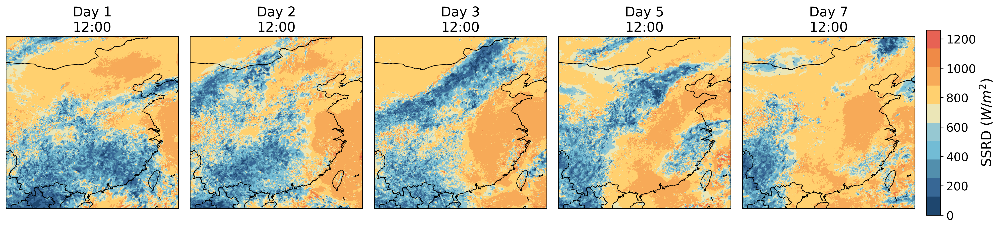

Plotting complete


In [2]:
import os
import xarray as xr
import matplotlib.pyplot as plt
import cartopy.crs as ccrs
import cartopy.feature as cfeature
import numpy as np
import datetime
import matplotlib as mpl
from matplotlib.gridspec import GridSpec
from matplotlib.colors import ListedColormap
import pandas as pd

color_list = ['#1e466e', '#376795', '#528fad', '#72bcd5', '#96c8d2', '#ebe6b7', '#ffd06f', '#f7aa58', '#ef8a47', '#e76254']
custom_cmap = ListedColormap(color_list)

pred_nc_path = './outputs/solar.nc'

lead_time_index = [54, 198, 342, 630, 918]
# Load prediction
with xr.open_dataset(pred_nc_path) as ds:
    stacked_daily_pred = ds['ssrd'].isel(time=0, lead_time=lead_time_index).values
    lons = ds['lon']
    lats = ds['lat']

# output_dir = "./output"
# os.makedirs(output_dir, exist_ok=True)


vmin_ssrd = stacked_daily_pred.min()
vmax_ssrd = stacked_daily_pred.max()

norm_ssrd = mpl.colors.Normalize(vmin=vmin_ssrd, vmax=vmax_ssrd)

# --- Plotting Configuration ---
n_col = 6
fig = plt.figure(figsize=(20, 4), dpi=300)

# Adjust width ratios for 7 columns: cbar1, pred1, gt1, pred2, gt2, error, cbar2
gs = GridSpec(1, n_col, figure=fig, width_ratios=[1, 1, 1, 1, 1, 0.08],
              height_ratios=[1], hspace=0.08, wspace=0.08)

current_day = [1, 2, 3, 5, 7]
# --- Plotting loop ---
for i_col in range(n_col):

    if i_col < n_col - 1:
        ax = fig.add_subplot(gs[0, i_col], projection=ccrs.PlateCarree())

        data = stacked_daily_pred[i_col]
        contour = ax.contourf(lons, lats, data, levels=100, cmap=custom_cmap, transform=ccrs.PlateCarree(), norm=norm_ssrd)
        
        ax.set_title(f"Day {current_day[i_col]}\n12:00", fontsize=16)
        # Common plot features
        ax.add_feature(cfeature.BORDERS, linewidth=0.8, edgecolor='black')
        ax.add_feature(cfeature.COASTLINE, linewidth=0.8)
        ax.set_extent([lons.min(), lons.max(), lats.min(), lats.max()], crs=ccrs.PlateCarree())
        ax.set_xticklabels([])
        ax.set_yticklabels([])
        ax.set_xticks([])
        ax.set_yticks([])

    else:

        cbar_ax = fig.add_subplot(gs[:, i_col])
        sm_ssrd = plt.cm.ScalarMappable(cmap=custom_cmap, norm=norm_ssrd)
        cbar = fig.colorbar(sm_ssrd, cax=cbar_ax, orientation='vertical')
        cbar.set_label('SSRD ($W/m^2$)', fontsize=16)
        cbar_ax.tick_params(labelsize=14)

plt.tight_layout()
plt.show()
print("Plotting complete")

<span style="font-size:20px;">4 Visualization</span><br>
<span style="font-size:18px;">4.1 Forecast and Ground Truth</span>

/tmp/ipykernel_1468/2930298019.py:95: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


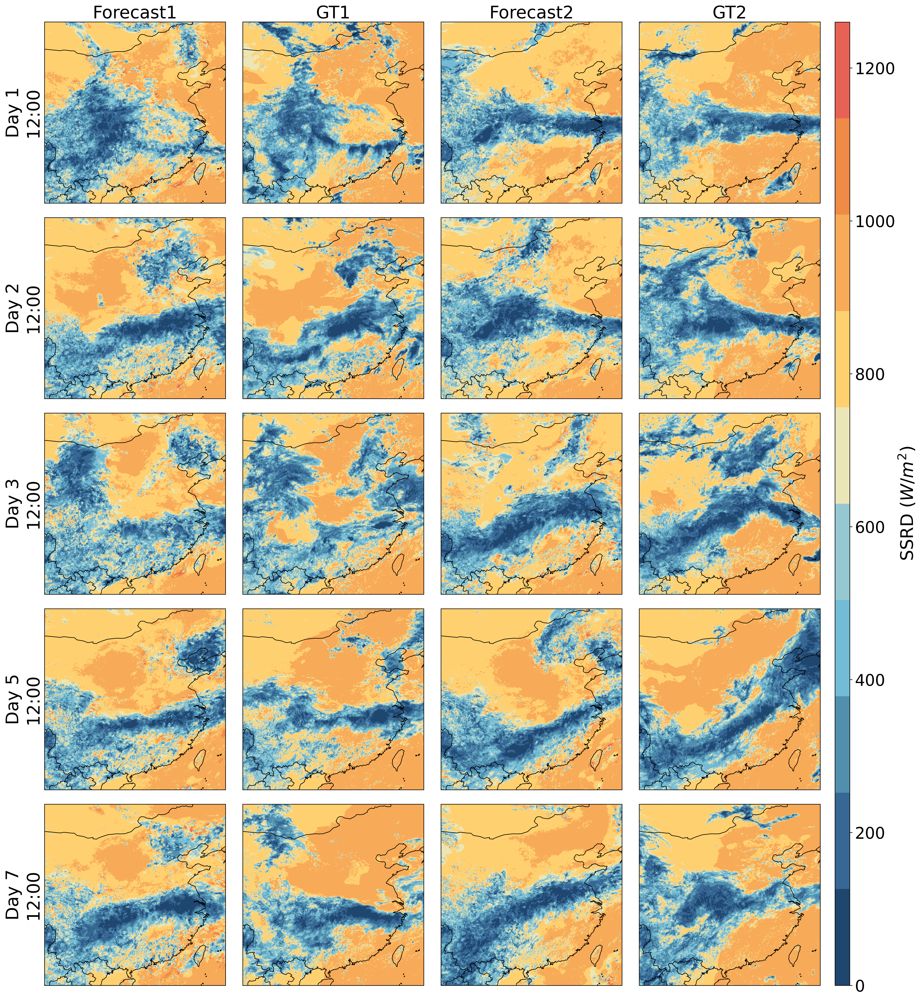

In [1]:
import os
import matplotlib.pyplot as plt
import cartopy.crs as ccrs
import cartopy.feature as cfeature
import numpy as np
import matplotlib as mpl
from matplotlib.gridspec import GridSpec
from matplotlib.colors import ListedColormap


color_list = ['#1e466e', '#376795', '#528fad', '#72bcd5', '#96c8d2', '#ebe6b7', '#ffd06f', '#f7aa58', '#ef8a47', '#e76254']
custom_cmap_prediction_gt = ListedColormap(color_list)

error_color_list = ['#f8f4f2', '#d4e6ef', '#99c8e0', '#4d9ac7', '#276faf', '#1b3b70']
error_cmap = ListedColormap(error_color_list)


def main(start_date, end_date):

    # output_dir = "./output"
    # os.makedirs(output_dir, exist_ok=True)

    data = np.load('./monthly_data/res.npz')
    avg_pred1 = data['pred1']
    avg_gt1 = data['gt1']
    avg_pred2 = data['pred2']
    avg_gt2 = data['gt2']
    lons = data['lon']
    lats = data['lat']


    # --- Determine global min/max for color scales ---
    vmin_ssrd = min(avg_pred1.min(), avg_gt1.min(), avg_pred2.min(), avg_gt2.min())
    vmax_ssrd = max(avg_pred1.max(), avg_gt1.max(), avg_pred2.max(), avg_gt2.max())
    norm_ssrd = mpl.colors.Normalize(vmin=vmin_ssrd, vmax=vmax_ssrd)

    # --- Plotting Configuration ---
    n_row = 5
    fig = plt.figure(figsize=(20, int(20 / 4.05 * n_row)), dpi=300)

    # Adjust width ratios for 7 columns: cbar1, pred1, gt1, pred2, gt2, error, cbar2
    gs = GridSpec(n_row, 5, figure=fig, width_ratios=[1, 1, 1, 1, 0.08],
                  height_ratios=[1] * n_row, hspace=0.08, wspace=0.08)

    current_day = [1, 2, 3, 5, 7]
    # --- Plotting loop ---
    for i_row in range(n_row):
        # Column 2-3 (Range 1: Prediction & Ground-Truth)
        ax1 = fig.add_subplot(gs[i_row, 0], projection=ccrs.PlateCarree())
        ax2 = fig.add_subplot(gs[i_row, 1], projection=ccrs.PlateCarree())
        
        # Column 4-5 (Range 2: Prediction & Ground-Truth)
        ax3 = fig.add_subplot(gs[i_row, 2], projection=ccrs.PlateCarree())
        ax4 = fig.add_subplot(gs[i_row, 3], projection=ccrs.PlateCarree())


        # Plot data
        axs = [ax1, ax2, ax3, ax4]
        data_sets = [avg_pred1, avg_gt1, avg_pred2, avg_gt2]
        cmaps = [custom_cmap_prediction_gt, custom_cmap_prediction_gt, custom_cmap_prediction_gt, custom_cmap_prediction_gt]
        norms = [norm_ssrd, norm_ssrd, norm_ssrd, norm_ssrd]

        for i_col, ax in enumerate(axs):
            data = data_sets[i_col][i_row]
            contour = ax.contourf(lons, lats, data, levels=100, cmap=cmaps[i_col], transform=ccrs.PlateCarree(), norm=norms[i_col])

            # Common plot features
            ax.add_feature(cfeature.BORDERS, linewidth=0.8, edgecolor='black')
            ax.add_feature(cfeature.COASTLINE, linewidth=0.8)
            ax.set_extent([lons.min(), lons.max(), lats.min(), lats.max()], crs=ccrs.PlateCarree())
            ax.set_xticklabels([])
            ax.set_yticklabels([])
            ax.set_xticks([])
            ax.set_yticks([])

        # Set titles for the first row
        if i_row == 0:
            ax1.set_title(f"Forecast1", fontsize=24, pad=2)
            ax2.set_title(f"GT1", fontsize=24, pad=2)
            ax3.set_title(f"Forecast2", fontsize=24, pad=2)
            ax4.set_title(f"GT2", fontsize=24, pad=2)

        # Set lead time labels on the first column (index 1)
        ax1.set_ylabel(f"Day {current_day[i_row]}\n12:00", fontsize=24)

    # --- Colorbar drawing ---
    # Left Colorbar (Prediction & Ground-Truth)
    cbar_ax = fig.add_subplot(gs[:, 4])
    sm_ssrd = plt.cm.ScalarMappable(cmap=custom_cmap_prediction_gt, norm=norm_ssrd)
    cbar = fig.colorbar(sm_ssrd, cax=cbar_ax, orientation='vertical')

    cbar.set_label('SSRD ($W/m^2$)', fontsize=24)
    cbar_ax.tick_params(labelsize=22)

    plt.tight_layout()
    plt.show()


main(None, None) # Dates are now hardcoded inside main

<span style="font-size:18px;">4.2 Annual Relative Error</span>

/tmp/ipykernel_1468/1361821901.py:120: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  cbar_right.ax.set_yticklabels(tick_labels)
/tmp/ipykernel_1468/1361821901.py:125: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


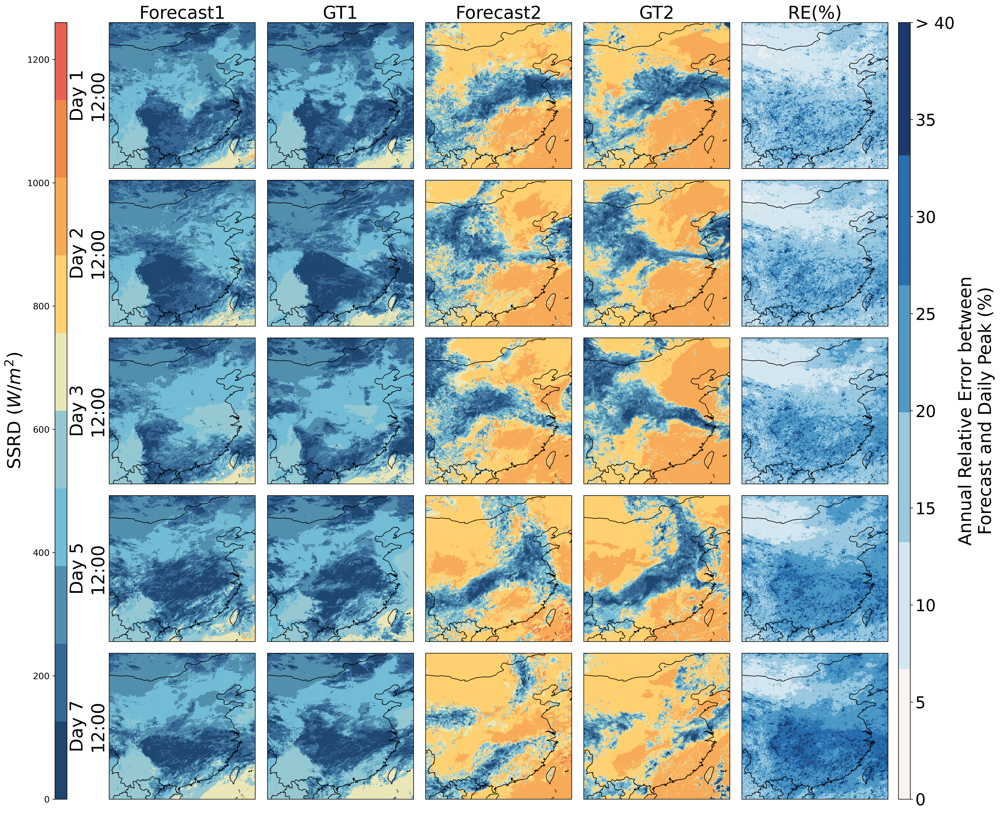

In [2]:
import os
import matplotlib.pyplot as plt
import cartopy.crs as ccrs
import cartopy.feature as cfeature
import numpy as np
import matplotlib as mpl
from matplotlib.gridspec import GridSpec
from matplotlib.colors import ListedColormap

color_list = ['#1e466e', '#376795', '#528fad', '#72bcd5', '#96c8d2', '#ebe6b7', '#ffd06f', '#f7aa58', '#ef8a47', '#e76254']
custom_cmap_prediction_gt = ListedColormap(color_list)

error_color_list = ['#f8f4f2', '#d4e6ef', '#99c8e0', '#4d9ac7', '#276faf', '#1b3b70']
error_cmap = ListedColormap(error_color_list)


def main(start_date, end_date):
    
    # output_dir = "./output"
    # os.makedirs(output_dir, exist_ok=True)
    
    data = np.load('./multi_range_data/res.npz')
    avg_pred1 = data['pred1']
    avg_gt1 = data['gt1']
    avg_pred2 = data['pred2']
    avg_gt2 = data['gt2']
    avg_error3 = data['error']
    lons = data['lon']
    lats = data['lat']
    
    # --- Determine global min/max for color scales ---
    vmin_ssrd = min(avg_pred1.min(), avg_gt1.min(), avg_pred2.min(), avg_gt2.min())
    vmax_ssrd = max(avg_pred1.max(), avg_gt1.max(), avg_pred2.max(), avg_gt2.max())

    clipping_value = 40
    norm_ssrd = mpl.colors.Normalize(vmin=vmin_ssrd, vmax=vmax_ssrd)
    norm_error = mpl.colors.Normalize(vmin=0, vmax=clipping_value)
    
    # Create smooth clipping cmap for error
    base_cmap = error_cmap
    base_colors = base_cmap(np.linspace(0, 1, 256))
    clipping_color = base_colors[-1]
    new_colors = np.vstack((base_colors, clipping_color))
    smooth_clipping_cmap = mpl.colors.ListedColormap(new_colors, name='smooth_clipping_cmap')
    
    # --- Plotting Configuration ---
    n_row = 5
    fig = plt.figure(figsize=(20, int(20 / 5.05 * n_row)), dpi=300)
    
    # Adjust width ratios for 7 columns: cbar1, pred1, gt1, pred2, gt2, error, cbar2
    gs = GridSpec(n_row, 7, figure=fig, width_ratios=[0.08, 1, 1, 1, 1, 1, 0.08],
                  height_ratios=[1] * n_row, hspace=0.08, wspace=0.08)

    current_day = [1, 2, 3, 5, 7]
    # --- Plotting loop ---
    for i_row in range(n_row):
        # Column 2-3 (Range 1: Prediction & Ground-Truth)
        ax1 = fig.add_subplot(gs[i_row, 1], projection=ccrs.PlateCarree())
        ax2 = fig.add_subplot(gs[i_row, 2], projection=ccrs.PlateCarree())
        
        # Column 4-5 (Range 2: Prediction & Ground-Truth)
        ax3 = fig.add_subplot(gs[i_row, 3], projection=ccrs.PlateCarree())
        ax4 = fig.add_subplot(gs[i_row, 4], projection=ccrs.PlateCarree())
        
        # Column 6 (Range 3: Abs Error)
        ax5 = fig.add_subplot(gs[i_row, 5], projection=ccrs.PlateCarree())
        
        # Plot data
        axs = [ax1, ax2, ax3, ax4, ax5]
        data_sets = [avg_pred1, avg_gt1, avg_pred2, avg_gt2, avg_error3]
        cmaps = [custom_cmap_prediction_gt, custom_cmap_prediction_gt, custom_cmap_prediction_gt, custom_cmap_prediction_gt, smooth_clipping_cmap]
        norms = [norm_ssrd, norm_ssrd, norm_ssrd, norm_ssrd, norm_error]
        
        for i_col, ax in enumerate(axs):
            data = data_sets[i_col][i_row] * 100 if i_col == 4 else data_sets[i_col][i_row]
            contour = ax.contourf(lons, lats, data, levels=100, cmap=cmaps[i_col], transform=ccrs.PlateCarree(), norm=norms[i_col])
            
            # Common plot features
            ax.add_feature(cfeature.BORDERS, linewidth=0.8, edgecolor='black')
            ax.add_feature(cfeature.COASTLINE, linewidth=0.8)
            ax.set_extent([lons.min(), lons.max(), lats.min(), lats.max()], crs=ccrs.PlateCarree())
            ax.set_xticklabels([])
            ax.set_yticklabels([])
            ax.set_xticks([])
            ax.set_yticks([])

        # Set titles for the first row
        if i_row == 0:
            ax1.set_title(f"Forecast1", fontsize=24, pad=2)
            ax2.set_title(f"GT1", fontsize=24, pad=2)
            ax3.set_title(f"Forecast2", fontsize=24, pad=2)
            ax4.set_title(f"GT2", fontsize=24, pad=2)
            ax5.set_title(f"RE(%)", fontsize=24, pad=2)
            
        # Set lead time labels on the first column (index 1)
        ax1.set_ylabel(f"Day {current_day[i_row]}\n12:00", fontsize=24)

    # --- Colorbar drawing ---
    # Left Colorbar (Prediction & Ground-Truth)
    cbar_ax_left = fig.add_subplot(gs[:, 0])
    sm_ssrd = plt.cm.ScalarMappable(cmap=custom_cmap_prediction_gt, norm=norm_ssrd)
    cbar_left = fig.colorbar(sm_ssrd, cax=cbar_ax_left, orientation='vertical')
    cbar_ax_left.yaxis.set_ticks_position('left')
    cbar_ax_left.yaxis.set_label_position('left')
    cbar_left.set_label('SSRD ($W/m^2$)', fontsize=24)
    cbar_ax_left.tick_params(labelsize=12)

    pos = cbar_ax_left.get_position()
    cbar_left_offset = -0.03  
    cbar_ax_left.set_position([pos.x0 + cbar_left_offset, pos.y0, pos.width, pos.height])  # 修改位置
    
    # Right Colorbar (Normalized Error)
    cbar_ax_right = fig.add_subplot(gs[:, 6])
    sm_error = plt.cm.ScalarMappable(cmap=smooth_clipping_cmap, norm=norm_error)
    cbar_right = fig.colorbar(sm_error, cax=cbar_ax_right, orientation='vertical')
    
    tick_labels = cbar_right.ax.get_yticklabels()
    if tick_labels:
      tick_labels[-1].set_text(f'> {clipping_value}')
      cbar_right.ax.set_yticklabels(tick_labels)
    
    cbar_right.set_label('Annual Relative Error between\nForecast and Daily Peak (%)', fontsize=24)
    cbar_ax_right.tick_params(labelsize=22)

    plt.tight_layout()
    plt.show()

    
main(None, None) # Dates are now hardcoded inside main


<span style="font-size:18px;">4.3  One-Day Forecast Inconsistency </span>


starting to plot...


/tmp/ipykernel_1468/3905811836.py:70: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  fig1.tight_layout()


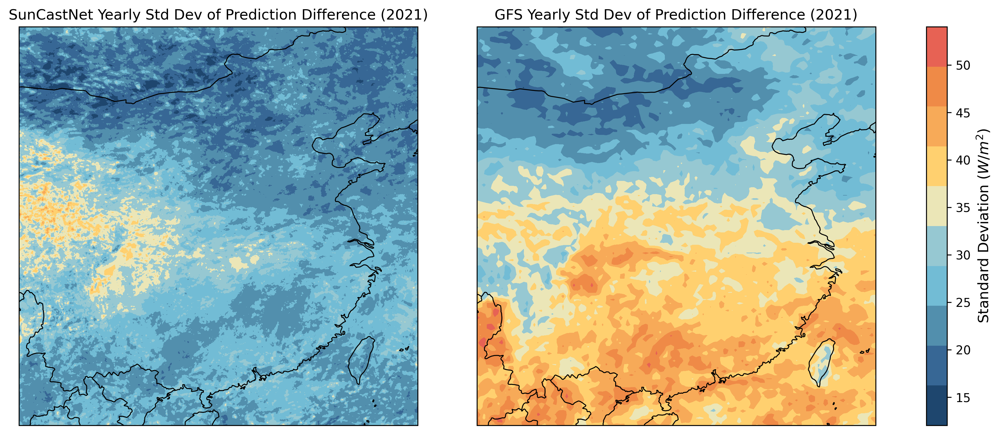

First chart plotting complete


/tmp/ipykernel_1468/3905811836.py:96: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  fig2.tight_layout()


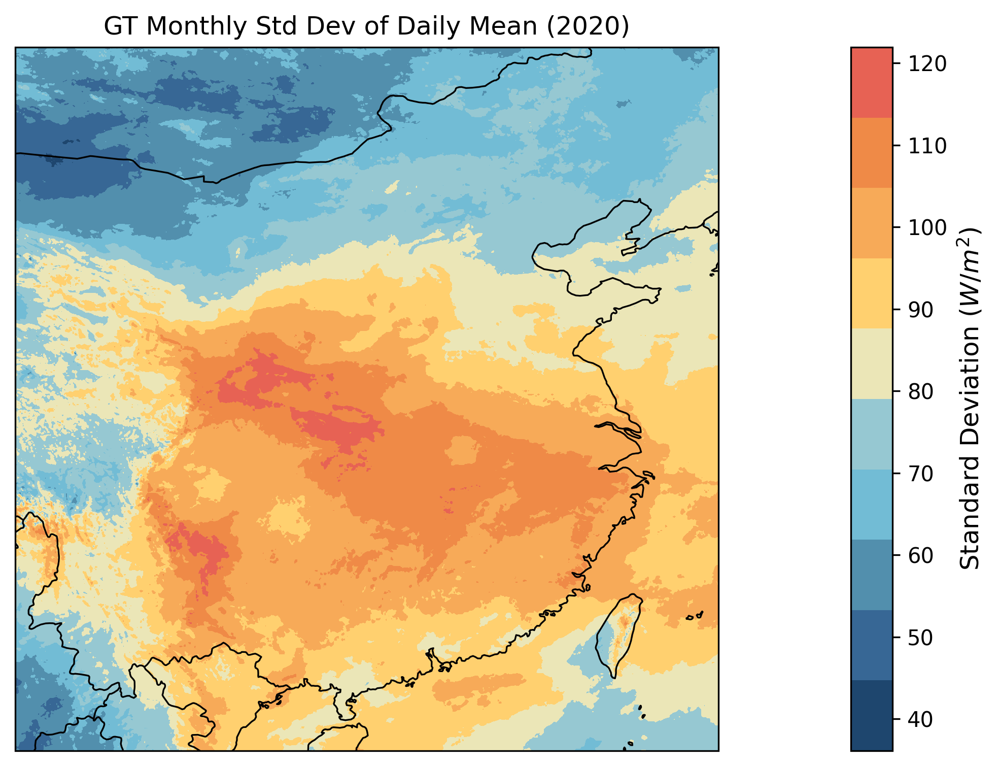

Second chart plotting complete


In [3]:
import matplotlib.pyplot as plt
import cartopy.crs as ccrs
import cartopy.feature as cfeature
import numpy as np
import matplotlib as mpl
from matplotlib.gridspec import GridSpec
from matplotlib.colors import ListedColormap
import os


if __name__ == "__main__":
    # output_path = './output'
    # os.makedirs(output_path, exist_ok=True)
       
    # --- custom color bar ---
    color_list = ['#1e466e', '#376795', '#528fad', '#72bcd5', '#96c8d2', '#ebe6b7', '#ffd06f', '#f7aa58', '#ef8a47', '#e76254']
    custom_cmap = ListedColormap(color_list)

    # load SunCastNet inference data
    sun_data = np.load('./monthly_std/suncastnet.npz')
    lons_sun = sun_data['lon']
    lats_sun = sun_data['lat']
    difference_std_sun = sun_data['var']

    # load GFS data
    gfs_data = np.load('./monthly_std/gfs.npz')
    lons_gfs = gfs_data['lon']
    lats_gfs = gfs_data['lat']
    difference_std_gfs = gfs_data['var']

    # load GT variance
    gt_data = np.load('./monthly_std/gt.npz')
    lons_gt = gt_data['lon']
    lats_gt = gt_data['lat']
    difference_std_gt = gt_data['var']


    # plot
    print("\nstarting to plot...")
    fig1 = plt.figure(figsize=(14, 6), dpi=300)

    gs1 = fig1.add_gridspec(1, 3, width_ratios=[1, 1, 0.05], wspace=0.15)

    # --- Determine uniform range for the first colorbar (SunCastNet and GFS) ---
    min_val1 = np.min([np.min(difference_std_sun), np.min(difference_std_gfs)])
    max_val1 = np.max([np.max(difference_std_sun), np.max(difference_std_gfs)])
    norm1 = mpl.colors.Normalize(vmin=min_val1, vmax=max_val1)


    # --- Plot: SunCastNet ---
    ax1 = fig1.add_subplot(gs1[0, 0], projection=ccrs.PlateCarree())
    std_plot1 = ax1.contourf(lons_sun, lats_sun, difference_std_sun, levels=100, cmap=custom_cmap, norm=norm1, transform=ccrs.PlateCarree())
    ax1.add_feature(cfeature.COASTLINE, linewidth=0.8)
    ax1.add_feature(cfeature.BORDERS, linewidth=0.8)
    ax1.set_title("SunCastNet Yearly Std Dev of Prediction Difference (2021)", fontsize=12)

    # --- Plot: GFS ---
    ax2 = fig1.add_subplot(gs1[0, 1], projection=ccrs.PlateCarree())
    std_plot2 = ax2.contourf(lons_gfs, lats_gfs, difference_std_gfs, levels=100, cmap=custom_cmap, norm=norm1, transform=ccrs.PlateCarree())
    ax2.add_feature(cfeature.COASTLINE, linewidth=0.8)
    ax2.add_feature(cfeature.BORDERS, linewidth=0.8)
    ax2.set_title("GFS Yearly Std Dev of Prediction Difference (2021)", fontsize=12)

    # --- Draw colorbar for SunCastNet and GFS ---
    cbar_ax1 = fig1.add_subplot(gs1[0, 2])
    sm_comp = plt.cm.ScalarMappable(cmap=custom_cmap, norm=norm1)
    cbar1 = fig1.colorbar(sm_comp, cax=cbar_ax1, orientation='vertical')
    cbar1.set_label('Standard Deviation ($W/m^2$)', fontsize=12)
    
    fig1.tight_layout()
    plt.show()
    print("First chart plotting complete")

    
    # --- Determine range for the second colorbar (GT) ---
    fig2 = plt.figure(figsize=(8, 6), dpi=300)
    gs2 = fig2.add_gridspec(1, 2, width_ratios=[1, 0.05], wspace=0.15)
    
    min_val2 = np.min(difference_std_gt)
    max_val2 = np.max(difference_std_gt)
    norm2 = mpl.colors.Normalize(vmin=min_val2, vmax=max_val2)
    
    
    ax3 = fig2.add_subplot(gs2[0, 0], projection=ccrs.PlateCarree())
    std_plot3 = ax3.contourf(lons_gt, lats_gt, difference_std_gt, levels=100, cmap=custom_cmap, norm=norm2, transform=ccrs.PlateCarree())
    ax3.add_feature(cfeature.COASTLINE, linewidth=0.8)
    ax3.add_feature(cfeature.BORDERS, linewidth=0.8)
    ax3.set_title("GT Monthly Std Dev of Daily Mean (2020)", fontsize=12)

    # --- Draw colorbar for GT ---
    cbar_ax2 = fig2.add_subplot(gs2[0, 1])
    sm_gt = plt.cm.ScalarMappable(cmap=custom_cmap, norm=norm2)
    cbar2 = fig2.colorbar(sm_gt, cax=cbar_ax2, orientation='vertical')
    cbar2.set_label('Standard Deviation ($W/m^2$)', fontsize=12)
    
    fig2.tight_layout()
    plt.show()
    print("Second chart plotting complete")

<span style="font-size:18px;">4.4 Surface Input Variables</span>

Loading data from: ./surface/era5_visualizations/20200101_020000/era5_20200101_020000.npz
Data loaded successfully. Keys: KeysView(NpzFile './surface/era5_visualizations/20200101_020000/era5_20200101_020000.npz' with keys: u10m, v10m, u100m, v100m, t2m...)
  - Generating plot for variable 'u10m'...


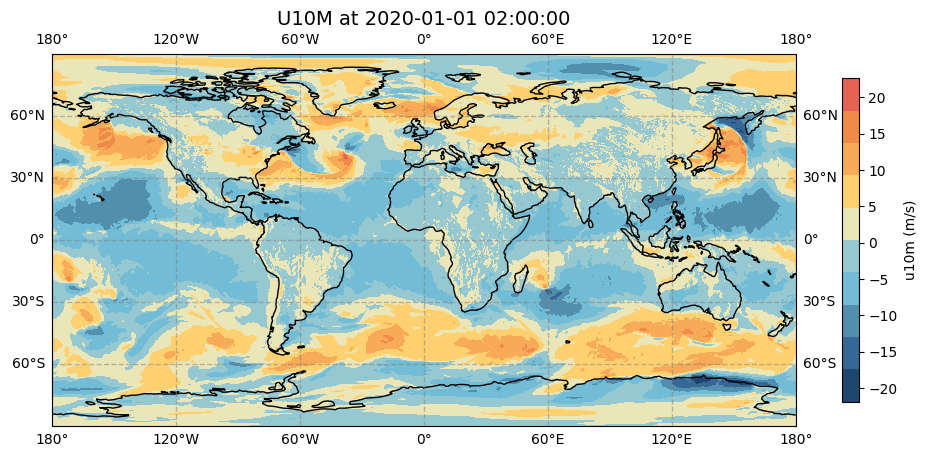

  - Generating plot for variable 'v10m'...


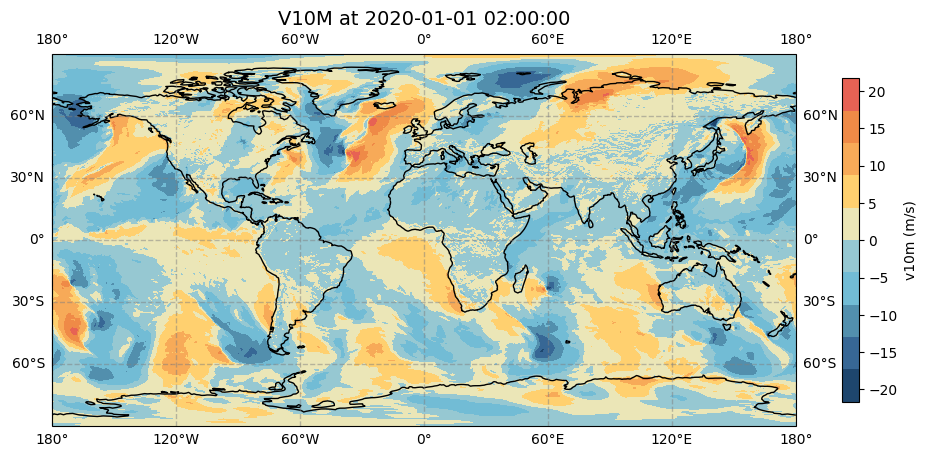

  - Generating plot for variable 'u100m'...


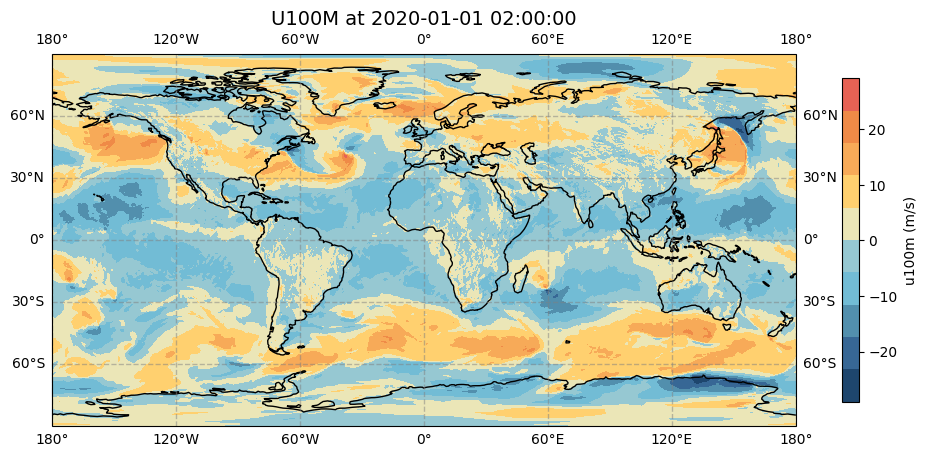

  - Generating plot for variable 'v100m'...


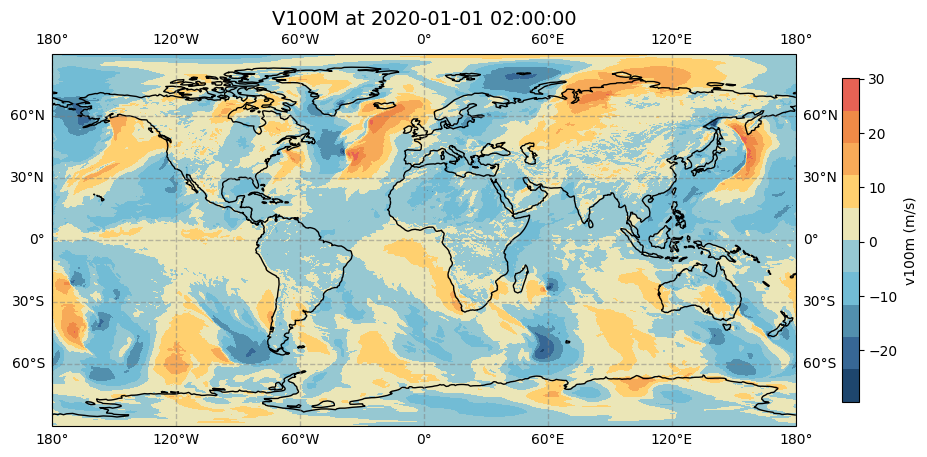

  - Generating plot for variable 't2m'...


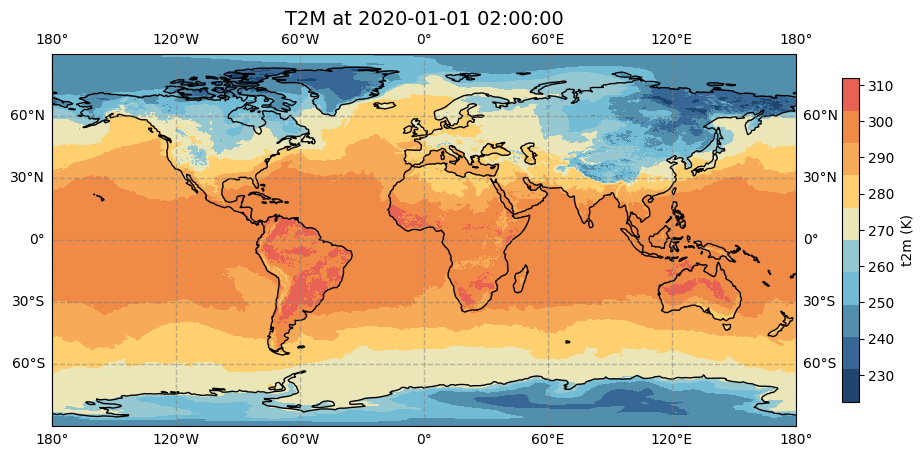

  - Generating plot for variable 'sp'...


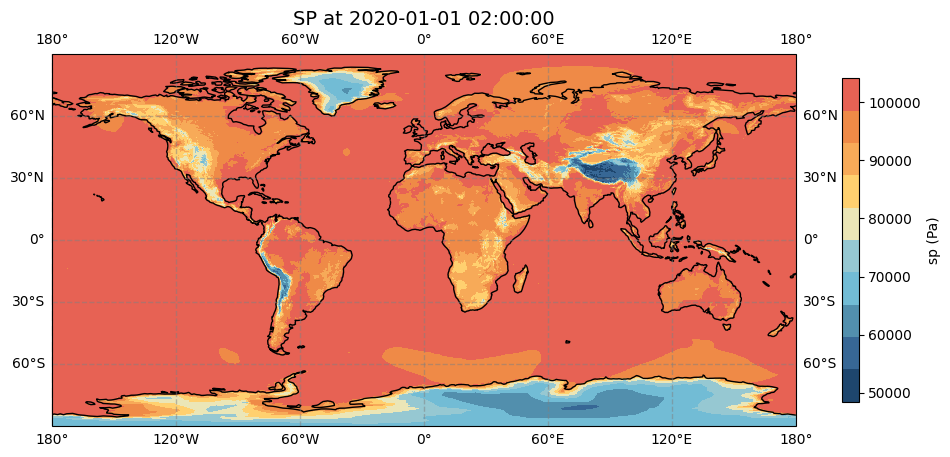

  - Generating plot for variable 'msl'...


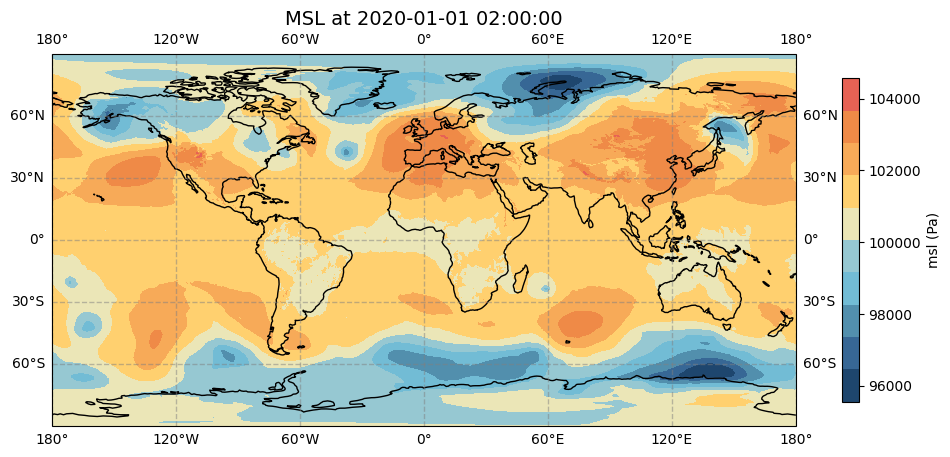

  - Generating plot for variable 'tcwv'...


In [ ]:
import matplotlib.pyplot as plt
import cartopy.crs as ccrs
import numpy as np
import os
from matplotlib.colors import ListedColormap
from datetime import datetime, timedelta

# Define custom colormap
color_list = ['#1e466e', '#376795', '#528fad', '#72bcd5', '#96c8d2', '#ebe6b7', '#ffd06f', '#f7aa58', '#ef8a47', '#e76254']
custom_cmap = ListedColormap(color_list)

def visualize_from_npz(npz_file_path, output_dir="visualizations_from_npz"):
    """
    Load ERA5 data from a saved .npz file and generate visualizations for each variable.
    
    Parameters:
    - npz_file_path (str): The path to the .npz file.
    - output_dir (str): Directory to save the generated visualization images.
    """
    # Create output directory
    # os.makedirs(output_dir, exist_ok=True)
    
    # Load the .npz file
    print(f"Loading data from: {npz_file_path}")
    data = np.load(npz_file_path)
    print("Data loaded successfully. Keys:", data.keys())
    
    # Extract longitude and latitude
    lon = data['lon']
    lat = data['lat']
    
    # Get all variable names (excluding 'lon' and 'lat')
    variables = [key for key in data.keys() if key not in ['lon', 'lat']]
    
    # Define plot parameters (can be adjusted based on requirements)
    plot_params = {
        'u10m': {'units': 'm/s', 'cmap': custom_cmap},
        'v10m': {'units': 'm/s', 'cmap': custom_cmap},
        'u100m': {'units': 'm/s', 'cmap': custom_cmap},
        'v100m': {'units': 'm/s', 'cmap': custom_cmap},
        't2m': {'units': 'K', 'cmap': custom_cmap},
        'sp': {'units': 'Pa', 'cmap': custom_cmap},
        'msl': {'units': 'Pa', 'cmap': custom_cmap},
        'tcwv': {'units': 'kg m**-2', 'cmap': custom_cmap},
        'default': {'units': 'unknown', 'cmap': custom_cmap}
    }
    
    # Extract time information to generate file names
    npz_file_base = os.path.basename(npz_file_path)
    time_str = npz_file_base[5:].replace(".npz", "")  # Extract time string
    target_time = datetime.strptime(time_str, '%Y%m%d_%H%M%S')
    
    for var in variables:
        print(f"  - Generating plot for variable '{var}'...")
        
        # Get current variable data
        var_data = data[var]
        
        # Fetch plot parameters
        params = plot_params.get(var, plot_params['default'])
        
        # Create the plot
        fig = plt.figure(figsize=(12, 6))
        ax = fig.add_subplot(1, 1, 1, projection=ccrs.PlateCarree())
        
        # Plot the data
        im = ax.pcolormesh(lon, lat, var_data, transform=ccrs.PlateCarree(), cmap=params['cmap'])
        
        # Add map features
        ax.coastlines()  # Add coastlines
        ax.gridlines(draw_labels=True, linewidth=1, color='gray', alpha=0.5, linestyle='--')
        
        # Add colorbar
        cbar = plt.colorbar(im, ax=ax, orientation="vertical", shrink=0.7)
        cbar.set_label(f"{var} ({params['units']})")
        
        # Add title
        ax.set_title(f"{var.upper()} at {target_time}", fontsize=14)
        
        # Save the image
        output_file_path = os.path.join(output_dir, f"{var}_{time_str}.png")
        plt.show()
    
    print(f"--- Visualization completed. ---")

if __name__ == "__main__":
    # Example: Load a generated .npz file to create plots
    npz_file_path = "./surface/era5_visualizations/20200101_020000/era5_20200101_020000.npz"
    visualize_from_npz(npz_file_path)